# Sessie 05 - Opdracht Decision Trees 

In [222]:
%matplotlib inline
import datetime
import calendar
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

from scipy import stats

from sklearn import preprocessing
from sklearn.preprocessing import PolynomialFeatures
from sklearn.linear_model import Ridge
from sklearn.linear_model import Lasso
from sklearn.metrics import r2_score, mean_absolute_error, mean_squared_error, RocCurveDisplay
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import RobustScaler
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix, accuracy_score, roc_curve, auc, ConfusionMatrixDisplay
from sklearn.preprocessing import OneHotEncoder
from sklearn import preprocessing
from sklearn.preprocessing import LabelEncoder
from sklearn import linear_model
from sklearn.linear_model import LogisticRegression
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import RandomizedSearchCV
from scipy.stats import randint 
from scipy.stats import uniform
from sklearn.svm import SVC
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import RandomForestRegressor
from sklearn.ensemble import BaggingClassifier
from sklearn.ensemble import AdaBoostClassifier
from sklearn.pipeline import Pipeline


pd.set_option('display.max_rows',1000)
pd.set_option('display.max_columns',1000)


def ismissing(df):
    all_columns = df.columns

    missing_arr = []
    missing_column = ['Column name', 'Number of missing values']

    for c in all_columns:
        mv = df[c].isnull().sum()
        if mv != 0:
            missing_row = [c, mv]
            missing_arr.append(missing_row)
    
    if not missing_arr:
        print("Er zijn geen ontbrekende waarden")
    else:
        missing_df = pd.DataFrame(missing_arr, columns = missing_column)
        return missing_df
    
def listdiff(li1, li2):
    li_dif = [i for i in li1 + li2 if i not in li1 or i not in li2]
    return li_dif

def ohe_and_bind(original_dataframe, features_to_encode):
    if type(features_to_encode) is not list:
        raise Exception("Features to encode needs to be a list")

    for f_encode in features_to_encode:
        dummies = pd.get_dummies(original_dataframe[[f_encode]])
        original_dataframe = original_dataframe.drop(f_encode, axis=1)
        original_dataframe = pd.concat([original_dataframe, dummies], axis=1)

    return(original_dataframe)

## Oefening 1. Energy consumption

In een goed geïsoleerd huis werden gedurende enkele maanden om de 10 minuten temperatuur- (in graden Celcius uitgedrukt) en vochtigheidsmetingen (in % uitgedrukt) gedaan. Er is ook weerdata beschikbaar van een nabij weerstation.
Tevens werd het elektrisch verbruik van de verlichting in het huis opgemeten samen met het elektrisch verbruik van andere toestellen.
De variabelen in de dataset hebben volgende betekenis:

- date time jaar-maand-dag uur:minuten:seconden
- Appliances: energieverbruik in Wh van elektrische toestellen in het huis
- lights: totaal energieverbruik van de verlichting in het huis in Wh
- T1: temperatuur in de keuken
- RH_1: vochtigheidsgraad in de keuken
- T2:  temperatuur in de living
- RH_2: vochtigheidsgraad in de living
- T3: temperatuur in de wasruimte
- RH_3: vochtigheidsgraad in de wasruimte 
- T4 temperatuur in het bureau
- RH_4: vochtigheidsgraad in het bureau 
- T5: temperatuur in de badkamer
- RH_5: vochtigheidsgraad in de badkamer
- T6: gemeten buitentemperatuur aan de noordkant van het huis
- RH_6: gemeten vochtigheidsgraad buiten aan de noordkant van het huis
- T7: temperatuur in de strijkruimte
- RH_7: vochtigheidsgraad in de strijkruimte
- T8: Temperatuur in kinderkamer 2
- RH_8: Vochtigheidsgraad in kindkamer 2
- T9: Temperatuur in de slaapkamer van de ouders
- RH_9: Vochtigheidsgraad in de slaapkamer van de ouders
- To: buitentemperatuur gemeten door het weerstation in de buurt
- Pressure: luchtdruk in mm Hg gemeten door het weerstation in de buurt
- RH_out: Vochtigheid buiten, gemeten door het weerstation in de buurt
- Windspeed: windsnelheid in m/s, gemeten door het weerstation in de buurt.
- Visibility: de zichtbaarheid in km, opgetekend door het weestation in de buurt.
- Tdewpoint: het dauwpunt gemeten door het weerstation in de buurt
- rv1: random variabele 1
- rv2, Random variable 2

De twee random variabelen rv1 en rv2 mogen uit de dataset worden verwijderd.

De bedoeling van deze opdracht is om een regressiemodel te trainen dat zo precies mogelijk het elektriciteitsverbruik van de toestellen (Appliances) kan voorspellen uit de andere variabelen.

In [3]:
energy = pd.read_csv('Energy_consumption.csv')
energy.head()

,date,Appliances,lights,T1,RH_1,T2,RH_2,T3,RH_3,T4,RH_4,T5,RH_5,T6,RH_6,T7,RH_7,T8,RH_8,T9,RH_9,T_out,Press_mm_hg,RH_out,Windspeed,Visibility,Tdewpoint,rv1,rv2
0,2016-01-11 17:00:00,60,30,19.89,47.596667,19.2,44.790000,19.79,44.730000,19.000000,45.566667,17.166667,55.20,7.026667,84.256667,17.200000,41.626667,18.2,48.900000,17.033333,45.53,6.600000,733.5,92.0,7.000000,63.000000,5.3,13.275433,13.275433
1,2016-01-11 17:10:00,60,30,19.89,46.693333,19.2,44.722500,19.79,44.790000,19.000000,45.992500,17.166667,55.20,6.833333,84.063333,17.200000,41.560000,18.2,48.863333,17.066667,45.56,6.483333,733.6,92.0,6.666667,59.166667,5.2,18.606195,18.606195
2,2016-01-11 17:20:00,50,30,19.89,46.300000,19.2,44.626667,19.79,44.933333,18.926667,45.890000,17.166667,55.09,6.560000,83.156667,17.200000,41.433333,18.2,48.730000,17.000000,45.50,6.366667,733.7,92.0,6.333333,55.333333,5.1,28.642668,28.642668
3,2016-01-11 17:30:00,50,40,19.89,46.066667,19.2,44.590000,19.79,45.000000,18.890000,45.723333,17.166667,55.09,6.433333,83.423333,17.133333,41.290000,18.1,48.590000,17.000000,45.40,6.250000,733.8,92.0,6.000000,51.500000,5.0,45.410389,45.410389
4,2016-01-11 17:40:00,60,40,19.89,46.333333,19.2,44.530000,19.79,45.000000,18.890000,45.530000,17.200000,55.09,6.366667,84.893333,17.200000,41.230000,18.1,48.590000,17.000000,45.40,6.133333,733.9,92.0,5.666667,47.666667,4.9,10.084097,10.084097


- Probeer eerst het elektriciteitsverbruik zo nauwkeurig mogelijk te voorspellen uit de andere variabelen gebruik makende van lineaire regressie, zoals je hebt gedaan in de sessie rond lineaire regressie.

- Train nu ook een Random Forest Regressor en optimaliseer deze via hyperparameter tuning: https://scikit-learn.org/stable/modules/generated/sklearn.ensemble.RandomForestRegressor.html


Je krijgt alle vrijheid in welke technieken je toepast. Jouw enige doel is een zo hoog mogelijke R²-score te behalen op een test set bestaande uit 5000 samples. Probeer ook zo goed mogelijk de datum en tijdstippen te gebruiken.

Bepaal uit de gertrainde Random Forest Classifier de belangrijkheid van de features (model.feature_importances_).
Welke zijn de 5 belangrijkste features?

### Analyse van de dataset
Alvorens te starten met de analyse van de dataset worden de random variabelen "rv1" en "rv2" verwijderd.

In [4]:
energy.drop(['rv1', 'rv2'], axis=1, inplace=True)
energy.head()

,date,Appliances,lights,T1,RH_1,T2,RH_2,T3,RH_3,T4,RH_4,T5,RH_5,T6,RH_6,T7,RH_7,T8,RH_8,T9,RH_9,T_out,Press_mm_hg,RH_out,Windspeed,Visibility,Tdewpoint
0,2016-01-11 17:00:00,60,30,19.89,47.596667,19.2,44.790000,19.79,44.730000,19.000000,45.566667,17.166667,55.20,7.026667,84.256667,17.200000,41.626667,18.2,48.900000,17.033333,45.53,6.600000,733.5,92.0,7.000000,63.000000,5.3
1,2016-01-11 17:10:00,60,30,19.89,46.693333,19.2,44.722500,19.79,44.790000,19.000000,45.992500,17.166667,55.20,6.833333,84.063333,17.200000,41.560000,18.2,48.863333,17.066667,45.56,6.483333,733.6,92.0,6.666667,59.166667,5.2
2,2016-01-11 17:20:00,50,30,19.89,46.300000,19.2,44.626667,19.79,44.933333,18.926667,45.890000,17.166667,55.09,6.560000,83.156667,17.200000,41.433333,18.2,48.730000,17.000000,45.50,6.366667,733.7,92.0,6.333333,55.333333,5.1
3,2016-01-11 17:30:00,50,40,19.89,46.066667,19.2,44.590000,19.79,45.000000,18.890000,45.723333,17.166667,55.09,6.433333,83.423333,17.133333,41.290000,18.1,48.590000,17.000000,45.40,6.250000,733.8,92.0,6.000000,51.500000,5.0
4,2016-01-11 17:40:00,60,40,19.89,46.333333,19.2,44.530000,19.79,45.000000,18.890000,45.530000,17.200000,55.09,6.366667,84.893333,17.200000,41.230000,18.1,48.590000,17.000000,45.40,6.133333,733.9,92.0,5.666667,47.666667,4.9


#### Ontbrekende en foutieve waarden
In een volgende stap wordt er onderzocht of er ontbrekende waarden zijn in de dataset. Daarna zal aan de hand van de `describe()`-method worden onderzocht of er outliers zijn.

In [5]:
ismissing(energy)

Er zijn geen ontbrekende waarden


**Conclusie over ontbrekende waarden**  
Er zijn geen ontbrekende waarden in de dataset.

In [6]:
energy.describe()

,Appliances,lights,T1,RH_1,T2,RH_2,T3,RH_3,T4,RH_4,T5,RH_5,T6,RH_6,T7,RH_7,T8,RH_8,T9,RH_9,T_out,Press_mm_hg,RH_out,Windspeed,Visibility,Tdewpoint
count,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000
mean,97.694958,3.801875,21.686571,40.259739,20.341219,40.420420,22.267611,39.242500,20.855335,39.026904,19.592106,50.949283,7.910939,54.609083,20.267106,35.388200,22.029107,42.936165,19.485828,41.552401,7.411665,755.522602,79.750418,4.039752,38.330834,3.760707
std,102.524891,7.935988,1.606066,3.979299,2.192974,4.069813,2.006111,3.254576,2.042884,4.341321,1.844623,9.022034,6.090347,31.149806,2.109993,5.114208,1.956162,5.224361,2.014712,4.151497,5.317409,7.399441,14.901088,2.451221,11.794719,4.194648
min,10.000000,0.000000,16.790000,27.023333,16.100000,20.463333,17.200000,28.766667,15.100000,27.660000,15.330000,29.815000,-6.065000,1.000000,15.390000,23.200000,16.306667,29.600000,14.890000,29.166667,-5.000000,729.300000,24.000000,0.000000,1.000000,-6.600000
25%,50.000000,0.000000,20.760000,37.333333,18.790000,37.900000,20.790000,36.900000,19.530000,35.530000,18.277500,45.400000,3.626667,30.025000,18.700000,31.500000,20.790000,39.066667,18.000000,38.500000,3.666667,750.933333,70.333333,2.000000,29.000000,0.900000
50%,60.000000,0.000000,21.600000,39.656667,20.000000,40.500000,22.100000,38.530000,20.666667,38.400000,19.390000,49.090000,7.300000,55.290000,20.033333,34.863333,22.100000,42.375000,19.390000,40.900000,6.916667,756.100000,83.666667,3.666667,40.000000,3.433333
75%,100.000000,0.000000,22.600000,43.066667,21.500000,43.260000,23.290000,41.760000,22.100000,42.156667,20.619643,53.663333,11.256000,83.226667,21.600000,39.000000,23.390000,46.536000,20.600000,44.338095,10.408333,760.933333,91.666667,5.500000,40.000000,6.566667
max,1080.000000,70.000000,26.260000,63.360000,29.856667,56.026667,29.236000,50.163333,26.200000,51.090000,25.795000,96.321667,28.290000,99.900000,26.000000,51.400000,27.230000,58.780000,24.500000,53.326667,26.100000,772.300000,100.000000,14.000000,66.000000,15.500000


Gebaseerd op de quantielen, het gemiddelde en de standaardeviatie zijn er 3 zaken die opvallen:
- De minimumwaarde van "T6" is negatief. Het gaat echter om een buitentemperatuur, bijgevolg is dit perfect mogelijk.
- De minimumwaarde van "T_out" is eveneens negatief. Ook hier gaat het om een buitentemperatuur, dus is dit perfect mogelijk.
- Voor de variabele "lights" is de minimumwaarde en de waarden van Q25, Q50 en Q75 gelijk aan 0. Dit wordt verder onderzocht door visueel onderzoek van de dataset. Mogelijk zijn de meeste meetingen overdag, waardoor er geen energieverbruik door lichten is.

In [7]:
energy.iloc[50:55,0:3]

,date,Appliances,lights
50,2016-01-12 01:20:00,120,10
51,2016-01-12 01:30:00,50,0
52,2016-01-12 01:40:00,40,0
53,2016-01-12 01:50:00,50,0
54,2016-01-12 02:00:00,40,0


Verder nazicht van de dataset, waarvan hierboven een slice wordt weergegeven, zijn de 0-waarden afkomstig van momenten tijdens de nacht en de dag wanneer geen lichten hoeven te worden aangedaan (bijvoorbeeld tijdens slapen)

**Conclusie over foutieve waarden**  
Er zijn geen foutieve waarden in deze data te weerhouden.

#### Visualisatie van de data
Doormiddel van een pairplot zal een overzicht kunnen worden bekomen van de onderliggene relaties tussen de variabelen. Een heatmap kan indicaties geven voor correlatiecoëfficiënten op basis van mogelijke lineaire correlaties.

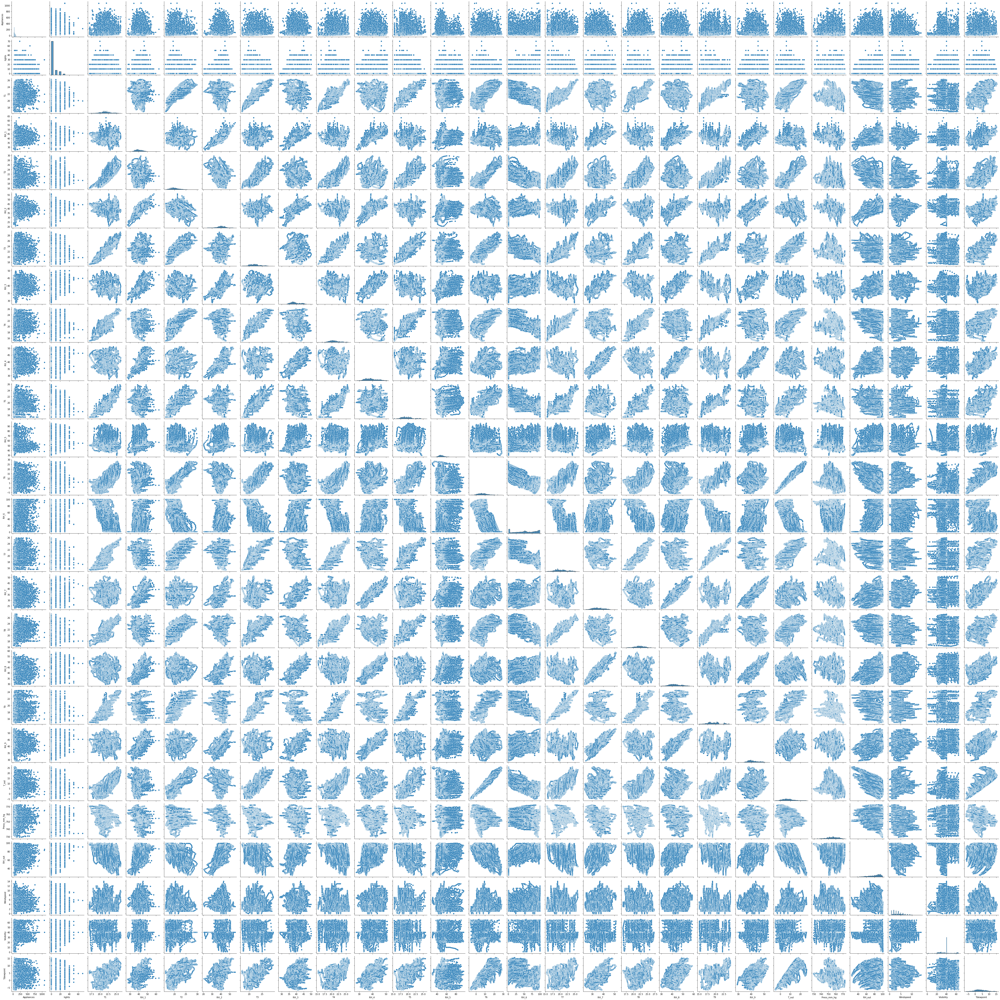

In [9]:
sns.pairplot(energy)

<AxesSubplot:>

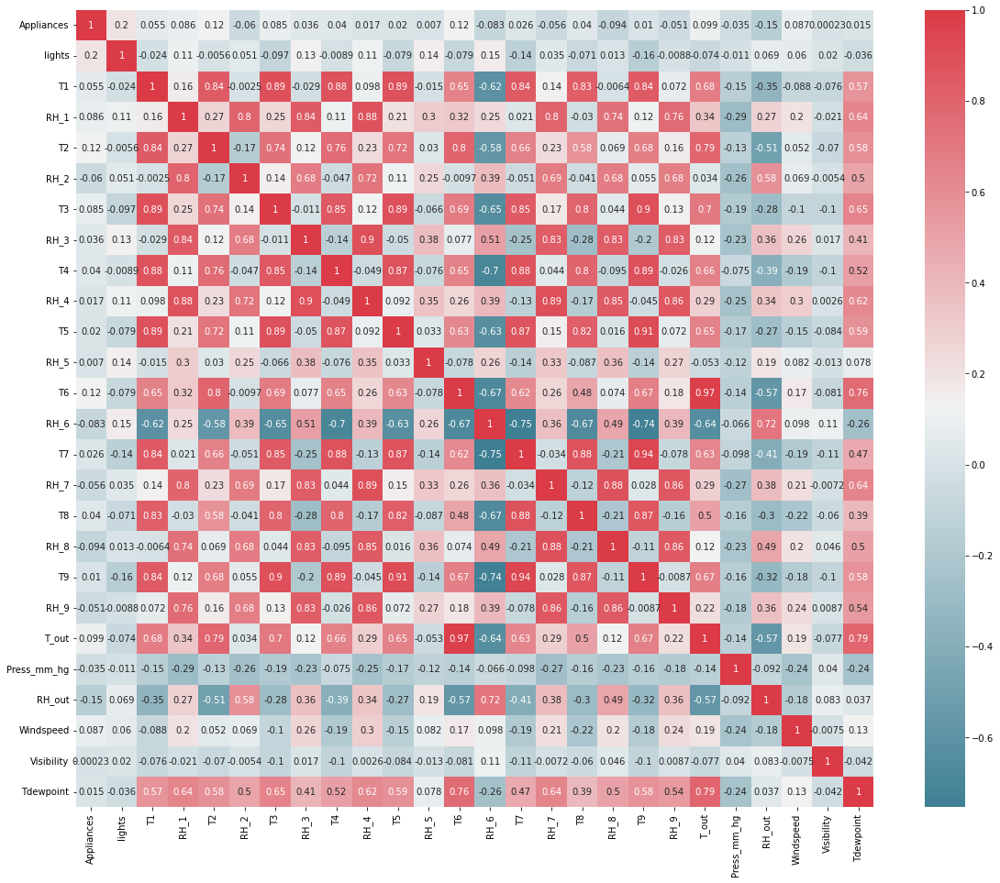

In [10]:
# Visualiseer de onderlinge correlatiecoëfficiënten
f, ax = plt.subplots(figsize=(20, 16))
corr = energy.corr()
sns.heatmap(corr, mask=np.zeros_like(corr, dtype=bool), cmap=sns.diverging_palette(220, 10, as_cmap=True),
            square=True, ax=ax,annot=True)

**Conclusie over pairplot van de data**  
Het pairplot toont enkele mooie correlaties tussen verschillende features, maar een mooie correlatie met het target wordt niet duidelijk gezien.

De correlatiecoëfficiënten zijn voor correlatie met de features en het target relatief laag. Twee features springen er uit. Dit zijn het verbruik door lichten ("lights" met een correlatiecoëfficiënt van 0,2) en de buitentemperatuur aan noordelijke zijde van het huis (T6 met een correlatiecoëfficiënt van 0,12).

### Preprocessing van de data
Volgende stappen worden ondernomen in de preprocessing:
- Date omzetten in bruikbare features
- Splitsen in target en features
- Splitsen in trainingset en testset
- Schalen van de features

#### Datum omzetten in bruikbare features
De eerte kolom met de data en tijden is van het type 'string' en voorlopig niet bruikbaar voor verder gebruik bij het trainen van modellen. In de volgende stappen worden de waarden omgezet tot datetime objecten, waarna het jaar, de maand, de dag van de maand, de dag van de week en het uur van elke waarde wordt afgeleid. Aangezien elk uut dezelfde minuten passeren, lijkt het niet nuttig om minuten als aparte feature te hebben.

In [8]:
# Datum omzetten in een datetime object
energy['date'] = pd.to_datetime(energy['date'])

# Datum en tijd opsplitsen in verschillende features
energy['year'] = energy['date'].dt.year
energy['month'] = energy['date'].dt.month
energy['day'] = energy['date'].dt.day
energy['dayofweek'] = energy['date'].dt.dayofweek
energy['hour'] = energy['date'].dt.hour
energy['is_weekend'] = energy.dayofweek.isin([5,6])*1
energy['is_winter'] = energy.month.isin([12,1,2])*1
energy['is_evening'] = energy.hour.isin([18,19,20,21,22,23])*1
energy['is_night'] = energy.hour.isin([0,1,2,3,4,5,6])*1
energy['is_day'] = energy.hour.isin([7,8,9,10,11,12,13,14,15,16,17])*1

# Datum en tijd opslaan in een variabele en kolom verwijderen
datecolumn = energy['date']
energy.drop('date', axis=1, inplace=True)
energy.head()

,Appliances,lights,T1,RH_1,T2,RH_2,T3,RH_3,T4,RH_4,T5,RH_5,T6,RH_6,T7,RH_7,T8,RH_8,T9,RH_9,T_out,Press_mm_hg,RH_out,Windspeed,Visibility,Tdewpoint,year,month,day,dayofweek,hour,is_weekend,is_winter,is_evening,is_night,is_day
0,60,30,19.89,47.596667,19.2,44.790000,19.79,44.730000,19.000000,45.566667,17.166667,55.20,7.026667,84.256667,17.200000,41.626667,18.2,48.900000,17.033333,45.53,6.600000,733.5,92.0,7.000000,63.000000,5.3,2016,1,11,0,17,0,1,0,0,1
1,60,30,19.89,46.693333,19.2,44.722500,19.79,44.790000,19.000000,45.992500,17.166667,55.20,6.833333,84.063333,17.200000,41.560000,18.2,48.863333,17.066667,45.56,6.483333,733.6,92.0,6.666667,59.166667,5.2,2016,1,11,0,17,0,1,0,0,1
2,50,30,19.89,46.300000,19.2,44.626667,19.79,44.933333,18.926667,45.890000,17.166667,55.09,6.560000,83.156667,17.200000,41.433333,18.2,48.730000,17.000000,45.50,6.366667,733.7,92.0,6.333333,55.333333,5.1,2016,1,11,0,17,0,1,0,0,1
3,50,40,19.89,46.066667,19.2,44.590000,19.79,45.000000,18.890000,45.723333,17.166667,55.09,6.433333,83.423333,17.133333,41.290000,18.1,48.590000,17.000000,45.40,6.250000,733.8,92.0,6.000000,51.500000,5.0,2016,1,11,0,17,0,1,0,0,1
4,60,40,19.89,46.333333,19.2,44.530000,19.79,45.000000,18.890000,45.530000,17.200000,55.09,6.366667,84.893333,17.200000,41.230000,18.1,48.590000,17.000000,45.40,6.133333,733.9,92.0,5.666667,47.666667,4.9,2016,1,11,0,17,0,1,0,0,1


In [9]:
energy['year'].value_counts()

2016    19735
Name: year, dtype: int64

In [10]:
print(f"'month': \t{list(energy['month'].unique())}")
print(f"'day': \t\t{list(energy['day'].unique())}")
print(f"'dayofweek': \t{list(energy['dayofweek'].unique())}")
print(f"'hour': \t{list(energy['hour'].unique())}")

'month': 	[1, 2, 3, 4, 5]
'day': 		[11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10]
'dayofweek': 	[0, 1, 2, 3, 4, 5, 6]
'hour': 	[17, 18, 19, 20, 21, 22, 23, 0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16]


Er is maar 1 waarde in de kolom 'year', namelijk 2016. Dit feature heeft bijgevolg geen informatieve waarde en wordt opnieuw verwijderd. De overige features bevatten wel meerdere waarden.

In [45]:
energy.drop('year', axis=1, inplace=True)

#### Splitsen in target en features
Het target is 'Appliances'. Alle overgebleven kolommen zijn de features.

In [47]:
# Splitsen in target en features
y_energy = energy['Appliances'].values
X_energy = energy.drop('Appliances', axis=1)

#### Splitsen in training en test set
Zoals opgegeven, zal de test set bestaan uit 5000 samples

In [48]:
# Splitsen in training en test set (n=5000)
X_energy_train, X_energy_test, y_energy_train, y_energy_test = train_test_split(X_energy, y_energy, test_size=5000, random_state=0)

#### Schalen van de data
Van de features wordt een geschaalde versie gemaakt voor gebruik bij lineaire regressie. Op basis van de eerdere pairplot is duidelijk dat de meeste features geen normaalverdeling volgen en dat er enkele features gekenmerkt worden door uitschieters. Daarom wordt er geopteerd voor de StandardScaler. De oorspronkelijke, niet geschaalde data zal ook worden behouden voor gebruik bij de RandomForestRegressor (beter transparantie).

In [49]:
cols_date = ['month', 'day', 'dayofweek', 'hour', 'is_weekend', 'is_evening', 'is_winter', 'is_night', 'is_day']
all_col = list(X_energy.columns)
col_to_scale = listdiff(all_col, cols_date)

X_energy_train_ss = X_energy_train.copy()
X_energy_test_ss = X_energy_test.copy()

trainss = X_energy_train_ss[col_to_scale]
testss = X_energy_test_ss[col_to_scale]

ss = StandardScaler().fit(trainss.values)
trainss = ss.transform(trainss.values)
testss = ss.transform(testss.values)

X_energy_train_ss[col_to_scale] = trainss
X_energy_test_ss[col_to_scale] = testss

X_energy_train_ss.head()

,lights,T1,RH_1,T2,RH_2,T3,RH_3,T4,RH_4,T5,RH_5,T6,RH_6,T7,RH_7,T8,RH_8,T9,RH_9,T_out,Press_mm_hg,RH_out,Windspeed,Visibility,Tdewpoint,month,day,dayofweek,hour,is_weekend,is_winter,is_evening,is_night,is_day
7029,-0.48144,-1.159807,-1.331839,-0.551545,-2.024942,-0.935052,-1.517751,-0.711878,-1.604203,-1.356799,-0.222355,-0.478925,-0.710586,-0.091888,-1.570593,-0.765366,-1.653022,-0.636893,-0.398945,-0.478789,0.973277,-1.708970,1.209487,-0.919639,-1.772130,2,29,0,12,0,1,0,0,1
19478,-0.48144,1.552962,-0.354127,1.323413,-0.689769,1.320820,-0.526359,1.527984,-0.068568,0.963972,-0.057180,1.419118,-1.133643,1.455501,0.220738,1.129795,-0.227114,1.304409,-0.355850,0.743886,0.169881,0.549653,-0.558759,-0.200944,1.348984,5,25,2,23,0,0,1,0,0
17390,-0.48144,1.937963,2.434619,3.227676,0.408592,1.631975,2.269838,2.487416,1.433759,2.293245,0.269667,2.604105,-1.552826,2.063708,1.703385,1.666047,1.141873,2.145640,1.556762,2.170863,-0.950823,-0.484144,-1.238853,-0.482785,2.393342,5,11,2,11,0,0,0,0,1
12940,-0.48144,0.486793,-0.459236,1.325491,-1.290628,0.170821,-0.169222,0.512699,-0.492858,0.552791,0.426817,1.094408,-1.472615,1.012855,-0.523704,0.161779,-1.213459,0.607531,-0.432747,0.982763,-0.401723,-1.383099,0.257355,-0.482785,0.256794,4,10,6,13,1,0,0,0,1
8826,-0.48144,-0.114050,-1.071736,-0.776363,-0.378129,-1.080167,-0.857352,-0.466963,-0.885641,-0.340170,-0.442067,-1.098823,0.191630,0.252056,-0.974611,0.751073,-1.167593,-0.293432,-0.594515,-1.110556,1.709161,0.482231,-0.830797,1.659207,-0.994841,3,13,6,0,1,0,0,1,0


### Trainen van regressiemodellen
Met de gepreprocessete data worden achtereenvolgens lineaire regressiemodellen en RandomForestRegressor modellen getraind. Cross validatie en hyperparametertuning wordt uitgevoerd door middel van Grid Search

#### Lineaire regressie
Allereerst wordt een simpele lineaire regressie getraind. Het model wordt daarna getuned door middel van feature engineering (polynomiale expansie) en door middel van regularisatie. Hyperparameter tuning gebeurd door middel van Grid Search

In [124]:
# Model initiatie
linreg = LinearRegression()

# Model trainen
linreg.fit(X_energy_train_ss, y_energy_train)

# Model evaluatie
y_energy_test_pred_linreg = linreg.predict(X_energy_test_ss)
y_energy_train_pred_linreg = linreg.predict(X_energy_train_ss)
mae = mean_absolute_error(y_energy_test,y_energy_test_pred_linreg)
mse = mean_squared_error(y_energy_test,y_energy_test_pred_linreg)
r2_test = r2_score(y_energy_test,y_energy_test_pred_linreg)
r2_train = r2_score(y_energy_train,y_energy_train_pred_linreg)

print("Lineaire regressie zonder feature expansion of regularisatie:")
print(f'MAE = \t{mae}')
print(f'MSE = \t{mse}')
print(f'R² test = \t{r2_test}')
print(f'R² train = \t{r2_train}')

Lineaire regressie zonder feature expansion of regularisatie:
MAE = 	54.043890625
MSE = 	9325.225310986329
R² test = 	0.1736985014237753
R² train = 	0.19776463831573288


Een lineaire regressie model op deze dataset zonder feature expansion of regularisatie heeft een zeer slechte performantie ten gevolge van underfitting. Er is een zeer slechter R²-score voor zowel de training set als de test set (0,173 en 0,150 respectievelijk).

In een volgende stap wordt polynomiale expansie uitgevoerd.

In [125]:
# Polynomial expansion
graad = 2

poly = PolynomialFeatures(graad)
poly.fit(X_energy_train_ss)
X_energy_train_poly = pd.DataFrame(poly.transform(X_energy_train_ss), columns=poly.get_feature_names_out())
X_energy_test_poly = pd.DataFrame(poly.transform(X_energy_test_ss), columns=poly.get_feature_names_out())

In [126]:
X_energy_train_poly.head()

,1,lights,T1,RH_1,T2,RH_2,T3,RH_3,T4,RH_4,T5,RH_5,T6,RH_6,T7,RH_7,T8,RH_8,T9,RH_9,T_out,Press_mm_hg,RH_out,Windspeed,Visibility,Tdewpoint,year,month,day,dayofweek,hour,is_weekend,is_winter,is_evening,is_night,is_day,lights^2,lights T1,lights RH_1,lights T2,lights RH_2,lights T3,lights RH_3,lights T4,lights RH_4,lights T5,lights RH_5,lights T6,lights RH_6,lights T7,lights RH_7,lights T8,lights RH_8,lights T9,lights RH_9,lights T_out,lights Press_mm_hg,lights RH_out,lights Windspeed,lights Visibility,lights Tdewpoint,lights year,lights month,lights day,lights dayofweek,lights hour,lights is_weekend,lights is_winter,lights is_evening,lights is_night,lights is_day,T1^2,T1 RH_1,T1 T2,T1 RH_2,T1 T3,T1 RH_3,T1 T4,T1 RH_4,T1 T5,T1 RH_5,T1 T6,T1 RH_6,T1 T7,T1 RH_7,T1 T8,T1 RH_8,T1 T9,T1 RH_9,T1 T_out,T1 Press_mm_hg,T1 RH_out,T1 Windspeed,T1 Visibility,T1 Tdewpoint,T1 year,T1 month,T1 day,T1 dayofweek,T1 hour,T1 is_weekend,T1 is_winter,T1 is_evening,T1 is_night,T1 is_day,RH_1^2,RH_1 T2,RH_1 RH_2,RH_1 T3,RH_1 RH_3,RH_1 T4,RH_1 RH_4,RH_1 T5,RH_1 RH_5,RH_1 T6,RH_1 RH_6,RH_1 T7,RH_1 RH_7,RH_1 T8,RH_1 RH_8,RH_1 T9,RH_1 RH_9,RH_1 T_out,RH_1 Press_mm_hg,RH_1 RH_out,RH_1 Windspeed,RH_1 Visibility,RH_1 Tdewpoint,RH_1 year,RH_1 month,RH_1 day,RH_1 dayofweek,RH_1 hour,RH_1 is_weekend,RH_1 is_winter,RH_1 is_evening,RH_1 is_night,RH_1 is_day,T2^2,T2 RH_2,T2 T3,T2 RH_3,T2 T4,T2 RH_4,T2 T5,T2 RH_5,T2 T6,T2 RH_6,T2 T7,T2 RH_7,T2 T8,T2 RH_8,T2 T9,T2 RH_9,T2 T_out,T2 Press_mm_hg,T2 RH_out,T2 Windspeed,T2 Visibility,T2 Tdewpoint,T2 year,T2 month,T2 day,T2 dayofweek,T2 hour,T2 is_weekend,T2 is_winter,T2 is_evening,T2 is_night,T2 is_day,RH_2^2,RH_2 T3,RH_2 RH_3,RH_2 T4,RH_2 RH_4,RH_2 T5,RH_2 RH_5,RH_2 T6,RH_2 RH_6,RH_2 T7,RH_2 RH_7,RH_2 T8,RH_2 RH_8,RH_2 T9,RH_2 RH_9,RH_2 T_out,RH_2 Press_mm_hg,RH_2 RH_out,RH_2 Windspeed,RH_2 Visibility,RH_2 Tdewpoint,RH_2 year,RH_2 month,RH_2 day,RH_2 dayofweek,RH_2 hour,RH_2 is_weekend,RH_2 is_winter,RH_2 is_evening,RH_2 is_night,RH_2 is_day,T3^2,T3 RH_3,T3 T4,T3 RH_4,T3 T5,T3 RH_5,T3 T6,T3 RH_6,T3 T7,T3 RH_7,T3 T8,T3 RH_8,T3 T9,T3 RH_9,T3 T_out,T3 Press_mm_hg,T3 RH_out,T3 Windspeed,T3 Visibility,T3 Tdewpoint,T3 year,T3 month,T3 day,T3 dayofweek,T3 hour,T3 is_weekend,T3 is_winter,T3 is_evening,T3 is_night,T3 is_day,RH_3^2,RH_3 T4,RH_3 RH_4,RH_3 T5,RH_3 RH_5,RH_3 T6,RH_3 RH_6,RH_3 T7,RH_3 RH_7,RH_3 T8,RH_3 RH_8,RH_3 T9,RH_3 RH_9,RH_3 T_out,RH_3 Press_mm_hg,RH_3 RH_out,RH_3 Windspeed,RH_3 Visibility,RH_3 Tdewpoint,RH_3 year,RH_3 month,RH_3 day,RH_3 dayofweek,RH_3 hour,RH_3 is_weekend,RH_3 is_winter,RH_3 is_evening,RH_3 is_night,RH_3 is_day,T4^2,T4 RH_4,T4 T5,T4 RH_5,T4 T6,T4 RH_6,T4 T7,T4 RH_7,T4 T8,T4 RH_8,T4 T9,T4 RH_9,T4 T_out,T4 Press_mm_hg,T4 RH_out,T4 Windspeed,T4 Visibility,T4 Tdewpoint,T4 year,T4 month,T4 day,T4 dayofweek,T4 hour,T4 is_weekend,T4 is_winter,T4 is_evening,T4 is_night,T4 is_day,RH_4^2,RH_4 T5,RH_4 RH_5,RH_4 T6,RH_4 RH_6,RH_4 T7,RH_4 RH_7,RH_4 T8,RH_4 RH_8,RH_4 T9,RH_4 RH_9,RH_4 T_out,RH_4 Press_mm_hg,RH_4 RH_out,RH_4 Windspeed,RH_4 Visibility,RH_4 Tdewpoint,RH_4 year,RH_4 month,RH_4 day,RH_4 dayofweek,RH_4 hour,RH_4 is_weekend,RH_4 is_winter,RH_4 is_evening,RH_4 is_night,RH_4 is_day,T5^2,T5 RH_5,T5 T6,T5 RH_6,T5 T7,T5 RH_7,T5 T8,T5 RH_8,T5 T9,T5 RH_9,T5 T_out,T5 Press_mm_hg,T5 RH_out,T5 Windspeed,T5 Visibility,T5 Tdewpoint,T5 year,T5 month,T5 day,T5 dayofweek,T5 hour,T5 is_weekend,T5 is_winter,T5 is_evening,T5 is_night,T5 is_day,RH_5^2,RH_5 T6,RH_5 RH_6,RH_5 T7,RH_5 RH_7,RH_5 T8,RH_5 RH_8,RH_5 T9,RH_5 RH_9,RH_5 T_out,RH_5 Press_mm_hg,RH_5 RH_out,RH_5 Windspeed,RH_5 Visibility,RH_5 Tdewpoint,RH_5 year,RH_5 month,RH_5 day,RH_5 dayofweek,RH_5 hour,RH_5 is_weekend,RH_5 is_winter,RH_5 is_evening,RH_5 is_night,RH_5 is_day,T6^2,T6 RH_6,T6 T7,T6 RH_7,T6 T8,T6 RH_8,T6 T9,T6 RH_9,T6 T_out,T6 Press_mm_hg,T6 RH_out,T6 Windspeed,T6 Visibility,T6 Tdewpoint,T6 year,T6 month,T6 day,T6 dayofweek,T6 hour,T6 is_weekend,T6 is_winter,T6 is_evening,T6 is_night,T6 is_day,RH_6^2,RH_6 T7,RH_6 RH_7,RH_6 T8,RH_6 RH_8,RH_6 T9,RH_

In [127]:
X_energy_train_poly.shape

(14735, 666)

In [128]:
# Model initiatie
linreg = LinearRegression()

# Model trainen
linreg.fit(X_energy_train_poly, y_energy_train)

# Model evaluatie
y_energy_test_pred_linreg = linreg.predict(X_energy_test_poly)
y_energy_train_pred_linreg = linreg.predict(X_energy_train_poly)
mae = mean_absolute_error(y_energy_test,y_energy_test_pred_linreg)
mse = mean_squared_error(y_energy_test,y_energy_test_pred_linreg)
r2_test = r2_score(y_energy_test,y_energy_test_pred_linreg)
r2_train = r2_score(y_energy_train,y_energy_train_pred_linreg)

print("Lineaire regressie zonder feature expansion of regularisatie:")
print(f'MAE = \t{mae}')
print(f'MSE = \t{mse}')
print(f'R² test = \t{r2_test}')
print(f'R² train = \t{r2_train}')

Lineaire regressie zonder feature expansion of regularisatie:
MAE = 	49.03855258789063
MSE = 	7434.908016561734
R² test = 	0.3411981554350719
R² train = 	0.42344063479211935


De performantie wordt iets beter na polynomiale expansie, maar het model neigt nu naar overfitting op de trainingsset. Voor de trainingsset wordt een R²-score behaald van 0,793, maar op de testset bedraagt de R²-score slechts 0,454.

Er wordt overgegaan op regularisatie.

Voor graad 3
MAE = 	59.981827975463865
MSE = 	11737.900998386303
R² test = 	-0.04008695357518377
R² train = 	0.876481193592201

In [129]:
# Regression
ridgemodel = linear_model.Ridge(tol=0.0001,fit_intercept=True, max_iter=100000) # L2 regularisatie
lassomodel = linear_model.Lasso(tol=0.0001,fit_intercept=True, max_iter=100000) # L1 regularisatie
elasticmodel = linear_model.ElasticNet(tol=0.0001,fit_intercept=True, max_iter=100000)

# Initiate grids
param1 = {}
param1['regression__alpha'] = np.logspace(-2,3,6)
param1['regression'] = [ridgemodel]

param2 = {}
param2['regression__alpha'] = np.logspace(-2,3,6)
param2['regression'] = [lassomodel]

param3 = {}
param3['regression__alpha'] = np.logspace(-2,3,6)
param3['regression'] = [elasticmodel]

reg_params = [param1, param2, param3]

# Initiate pipeline
reg_pipeline = Pipeline([('regression', ridgemodel)])

# Initiate gridsearch
reg_gs = GridSearchCV(reg_pipeline, reg_params, cv=6, n_jobs=-1, scoring='r2', verbose=1)

# Fit grid search
reg_gs.fit(X_energy_train_poly, y_energy_train)

# Best parameters and score
print(f"Beste parameters:\t{reg_gs.best_params_}")
print(f"Beste score: \t{reg_gs.best_score_}")

# Model evaluatie
y_energy_test_pred_linreg = reg_gs.predict(X_energy_test_poly)
y_energy_train_pred_linreg = reg_gs.predict(X_energy_train_poly)
mae = mean_absolute_error(y_energy_test,y_energy_test_pred_linreg)
mse = mean_squared_error(y_energy_test,y_energy_test_pred_linreg)
r2_test = r2_score(y_energy_test,y_energy_test_pred_linreg)
r2_train = r2_score(y_energy_train,y_energy_train_pred_linreg)

print("Lineaire regressie met feature expansion en regularisatie:")
print(f'MAE = \t{mae}')
print(f'MSE = \t{mse}')
print(f'R² test = \t{r2_test}')
print(f'R² train = \t{r2_train}')

Fitting 6 folds for each of 18 candidates, totalling 108 fits


/home/glenn/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:645: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.071e+06, tolerance: 1.268e+04
  model = cd_fast.enet_coordinate_descent(
/home/glenn/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:645: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.060e+06, tolerance: 1.266e+04
  model = cd_fast.enet_coordinate_descent(
/home/glenn/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:645: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.960e+

Beste parameters:	{'regression': Ridge(max_iter=100000, tol=0.0001), 'regression__alpha': 1.0}
Beste score: 	0.3545562531671291
Lineaire regressie zonder feature expansion of regularisatie:
MAE = 	49.03855258789063
MSE = 	7434.908016561734
R² test = 	0.3411981554350719
R² train = 	0.42344063479211935


- Probeer eerst het elektriciteitsverbruik zo nauwkeurig mogelijk te voorspellen uit de andere variabelen gebruik makende van lineaire regressie, zoals je hebt gedaan in de sessie rond lineaire regressie.

- Train nu ook een Random Forest Regressor en optimaliseer deze via hyperparameter tuning: https://scikit-learn.org/stable/modules/generated/sklearn.ensemble.RandomForestRegressor.html


Je krijgt alle vrijheid in welke technieken je toepast. Jouw enige doel is een zo hoog mogelijke R²-score te behalen op een test set bestaande uit 5000 samples. Probeer ook zo goed mogelijk de datum en tijdstippen te gebruiken.

Bepaal uit de gertrainde Random Forest Classifier de belangrijkheid van de features (model.feature_importances_).
Welke zijn de 5 belangrijkste features?

In [130]:
# Initiate Random Forest Regressor
rfr = RandomForestRegressor()

# Initiate grid
rfr_params = {
    'n_estimators': range(1, 1001, 250),
    'max_depth': [None, 5, 10, 20],
    'min_samples_split': [2, 5, 10],
    'max_features': ['auto', 'sqrt', 'log2'],
}

# Random Forest Regressor met oorspronkelijke features
rfr_gs = GridSearchCV(
    rfr,
    rfr_params,
    cv=6,
    n_jobs=-1,
    scoring='r2',
    verbose=1
)

rfr_gs.fit(X_energy_train, y_energy_train)

# Best parameters and score
print(f"Beste parameters:\t{rfr_gs.best_params_}")
print(f"Beste score: \t{rfr_gs.best_score_}")

# Model evaluatie
y_energy_test_pred_rfr = rfr_gs.predict(X_energy_test)
y_energy_train_pred_rfr = rfr_gs.predict(X_energy_train)
mae = mean_absolute_error(y_energy_test,y_energy_test_pred_rfr)
mse = mean_squared_error(y_energy_test,y_energy_test_pred_rfr)
r2_test = r2_score(y_energy_test,y_energy_test_pred_rfr)
r2_train = r2_score(y_energy_train,y_energy_train_pred_rfr)

print("Random Forest zonder feature expansion")
print(f'MAE = \t{mae}')
print(f'MSE = \t{mse}')
print(f'R² test = \t{r2_test}')
print(f'R² train = \t{r2_train}')

Fitting 6 folds for each of 144 candidates, totalling 864 fits
Beste parameters:	{'max_depth': None, 'max_features': 'sqrt', 'min_samples_split': 2, 'n_estimators': 751}
Beste score: 	0.5647924508605358
Random Forest zonder feature expansion
MAE = 	32.55301997336884
MSE = 	5094.272445722614
R² test = 	0.5486001875904339
R² train = 	0.9447273653242069


In [134]:
feature_importances = [list(rfr_gs.best_estimator_.feature_importances_)]
feature_importances_df = pd.DataFrame(feature_importances, columns=X_energy_train.columns)
feature_importancefinal = feature_importances_df.sort_values(by=0,axis=1, ascending=False).transpose().head(5).rename(columns={0: 'Weights (sorted)'})
feature_importancefinal

,Weights (sorted)
hour,0.068980
RH_3,0.042039
T3,0.041891
RH_1,0.040362
RH_5,0.039445



#### Uitbreiding

Aangezien de data in de tijd evolueert kunnen we die beschouwen als een tijdreeks. Daarom kan het interessant zijn om te onderzoeken of er informatie uit de opeenvolging van de metingen te halen valt.

Bekijk daarom of je betere predicties kunt maken wanneer je meerdere opeenvolgende metingen gebruikt om het elektriciteitsverbruik te voorspellen.
Dit betekent dat je een nieuwe training set en test set dient aan te maken waarbij elke rij de oorspronkelijk features bevat aangevuld met de features van aantal voorgaande rijen.
Bijvoorbeeld wanneer je het elektriciteitsverbruik wilt voorspellen op basis van 3 opeenvolgende metingen dan bevat elke rij van X (later op te splitsen in X_train en X_test) de features van het huidige tijdstip, maar ook de features van het voorgaande tijdstip en het tijdstip daarvoor. Dit betekent dat in dit voorbeeld het aantal kolommen van X drie keer groter is geworden.

Probeer dit en bespreek of dit betere predicties oplevert.


##### Uitwerking van de uitbreiding
Voor het toevoegen van de de features van de voorgaande rijen worden er shift-versies van de huidige dataframe gemaakt. De verschillende dataframes worden dan samengevoegd. Aan het begin en het einde zullen er missing values zijn. Deze worden weggelaten. Ten slotte zullen er modellen worden getraind naar analogie van hierboven.

In [84]:
# Uitwerking
# Maken van df met periodeshifts
energy0 = energy.copy()
energy1 = energy0.shift(periods=1)
energy2 = energy0.shift(periods=2)

# Kolomnamen wijzigen voor het gemak
energy1 = energy1.add_suffix('_1')
energy2 = energy2.add_suffix('_2')

# Samenvoegen tot 1 dataframe
energyx = pd.concat([energy0, energy1, energy2], axis=1)

# Weglaten van onvolledige rijen
energyx.dropna(inplace=True)

In [85]:
# Splitsen in target en features
y_energyx = energyx['Appliances'].values
X_energyx = energyx.drop(['Appliances', 'Appliances_1', 'Appliances_2'], axis=1)

In [86]:
# Splitsen in training en test set (n=5000)
X_energyx_train, X_energyx_test, y_energyx_train, y_energyx_test = train_test_split(X_energyx, y_energyx, test_size=5000, random_state=0)

In [87]:
# Schalen van de data (alleen voor lineaire regressie)
cols_date = ['month', 'day', 'dayofweek', 'hour', 'is_weekend', 'is_evening', 'is_winter', 'is_night', 'is_day']
cols_date1 = ['month_1', 'day_1', 'dayofweek_1', 'hour_1', 'is_weekend_1', 'is_evening_1', 'is_winter_1', 'is_night_1', 'is_day_1']
cols_date2 = ['month_2', 'day_2', 'dayofweek_2', 'hour_2', 'is_weekend_2', 'is_evening_2', 'is_winter_2', 'is_night_2', 'is_day_2']
cols_datex = cols_date + cols_date1 + cols_date2

all_colx = list(X_energyx.columns)
col_to_scalex = listdiff(all_col, cols_datex)

X_energyx_train_ss = X_energyx_train.copy()
X_energyx_test_ss = X_energyx_test.copy()

trainxss = X_energyx_train_ss[col_to_scalex]
testxss = X_energyx_test_ss[col_to_scalex]

ssx = StandardScaler().fit(trainxss.values)
trainxss = ssx.transform(trainxss.values)
testxss = ssx.transform(testxss.values)

X_energyx_train_ss[col_to_scalex] = trainxss
X_energyx_test_ss[col_to_scalex] = testxss

X_energyx_train_ss.head()

,lights,T1,RH_1,T2,RH_2,T3,RH_3,T4,RH_4,T5,RH_5,T6,RH_6,T7,RH_7,T8,RH_8,T9,RH_9,T_out,Press_mm_hg,RH_out,Windspeed,Visibility,Tdewpoint,month,day,dayofweek,hour,is_weekend,is_winter,is_evening,is_night,is_day,lights_1,T1_1,RH_1_1,T2_1,RH_2_1,T3_1,RH_3_1,T4_1,RH_4_1,T5_1,RH_5_1,T6_1,RH_6_1,T7_1,RH_7_1,T8_1,RH_8_1,T9_1,RH_9_1,T_out_1,Press_mm_hg_1,RH_out_1,Windspeed_1,Visibility_1,Tdewpoint_1,month_1,day_1,dayofweek_1,hour_1,is_weekend_1,is_winter_1,is_evening_1,is_night_1,is_day_1,lights_2,T1_2,RH_1_2,T2_2,RH_2_2,T3_2,RH_3_2,T4_2,RH_4_2,T5_2,RH_5_2,T6_2,RH_6_2,T7_2,RH_7_2,T8_2,RH_8_2,T9_2,RH_9_2,T_out_2,Press_mm_hg_2,RH_out_2,Windspeed_2,Visibility_2,Tdewpoint_2,month_2,day_2,dayofweek_2,hour_2,is_weekend_2,is_winter_2,is_evening_2,is_night_2,is_day_2
16812,-0.482591,1.582379,-1.244728,3.770563,-2.921119,1.362185,-0.702750,1.390111,-0.625618,1.212207,1.910751,2.892119,-1.717096,1.244121,-0.397550,1.037708,-0.445602,1.353478,-0.116260,2.688506,-0.410225,-2.743659,-0.015273,0.136327,0.795411,5,7,5,11,1,0,0,0,1,0.0,24.10,36.550000,28.60,28.754000,25.00,36.966667,23.700000,36.466667,21.890000,71.856667,25.540000,1.000000,22.89,33.400000,23.926667,40.760000,22.254,41.32,21.300000,752.500000,41.000000,3.833333,40.000000,7.400000,1.416532,-1.072663,1.019125,-0.215921,1.615868,-0.750013,-0.579623,-0.644101,1.093770,0.0,24.066667,37.733333,28.600000,28.725714,25.000000,36.826667,23.7000,36.730000,21.926667,75.7300,25.225714,1.000000,22.804286,33.481429,23.856667,41.030000,22.200000,41.497143,20.900000,752.500000,43.000000,3.666667,40.000000,7.700000,1.416748,-1.072652,1.019000,-0.215362,1.615047,-0.750124,-0.578787,-0.644206,1.092723
17862,-0.482591,2.038895,-1.008545,1.441111,-2.006031,0.664504,-2.491851,1.971316,-1.442188,2.335942,-1.374184,0.619740,-1.717096,2.102502,-1.560510,2.317580,-1.622015,1.843589,-2.597627,0.786957,0.399686,-2.003437,1.616554,-0.796436,-0.567842,5,14,5,18,1,0,1,0,0,10.0,24.89,32.666667,23.56,31.140000,23.60,30.823333,24.856667,32.560000,23.890000,38.684286,11.763333,1.000000,24.70,27.356667,26.540000,34.296000,23.236,30.83,11.650000,758.433333,50.166667,7.833333,30.833333,1.483333,1.416532,-0.244044,1.019125,0.793285,1.615868,-0.750013,-0.579623,-0.644101,1.093770,0.0,24.926667,32.126667,23.600000,30.725714,23.463333,30.563333,24.7900,32.433333,23.890000,38.7000,12.033333,1.000000,24.760000,27.290000,26.500000,34.105714,23.290000,30.890000,11.700000,758.366667,50.333333,7.666667,32.666667,1.566667,1.416748,-0.243979,1.019000,0.794068,1.615047,-0.750124,-0.578787,-0.644206,1.092723
16057,-0.482591,-0.303861,-1.101842,-1.025368,-0.467153,0.098053,-0.931648,-0.242798,-1.095858,0.039535,-0.489484,-1.088181,-0.542524,-0.415733,-1.122093,0.209076,-0.230865,0.056206,-0.424081,-0.995353,1.286089,0.643421,-1.239143,-0.881232,-0.763162,5,2,0,5,0,0,0,1,0,0.0,21.20,35.900000,18.10,38.466667,22.50,36.290000,20.390000,34.290000,19.666667,46.700000,1.323333,37.026667,19.39,29.600000,22.500000,41.826667,19.600,39.79,2.200000,765.100000,89.000000,1.000000,28.000000,0.600000,1.416532,-1.664534,-1.505044,-0.936782,-0.618862,-0.750013,-0.579623,1.552552,-0.914269,0.0,21.200000,35.900000,18.133333,38.363333,22.500000,36.230000,20.3900,34.290000,19.600000,46.7675,1.390000,36.233333,19.390000,29.600000,22.500000,41.826667,19.633333,39.730000,2.166667,765.150000,89.666667,1.000000,30.000000,0.650000,1.416748,-1.664561,-1.504691,-1.080587,-0.619177,-0.750124,-0.578787,1.552297,-0.915145
14328,-0.482591,-0.366113,-0.595015,-1.040593,0.257453,0.061508,-0.415344,0.213049,-0.890830,0.200846,-0.359251,-1.053694,-0.225710,0.011086,-0.804372,-0.171600,-0.041730,0.254804,-0.062546,-0.756875,1.587556,0.553697,-0.423230,-0.881232,-0.543925,4,20,2,5,0,0,0,1,0,0.0,21.10,37.966667,18.10,41.466667,22.39,37.900000,21.332857,35.200000,19.890000,47.790000,1.633333,47.156667,20.29,31.290000,21.730000,42.700000,20.000,41.29,3.433333,767.300000,88.000000,3.000000,28.166667,1.550000,0.670730,0.466201,-0.495377,-1.080954,-0.618862,-0.750013,-0.579623,1.55

In [88]:
# Regression
# Initiate models
linregmodel = linear_model.LinearRegression()
ridgemodel = linear_model.Ridge(tol=0.0001,fit_intercept=True, max_iter=100000) # L2 regularisatie
lassomodel = linear_model.Lasso(tol=0.0001,fit_intercept=True, max_iter=100000) # L1 regularisatie
elasticmodel = linear_model.ElasticNet(tol=0.0001,fit_intercept=True, max_iter=100000)

# Initiate grids
param0 = {}
param0['regression'] = [linregmodel]

param1 = {}
param1['regression__alpha'] = np.logspace(-2,3,6)
param1['regression'] = [ridgemodel]

param2 = {}
param2['regression__alpha'] = np.logspace(-2,3,6)
param2['regression'] = [lassomodel]

param3 = {}
param3['regression__alpha'] = np.logspace(-2,3,6)
param3['regression'] = [elasticmodel]

reg_params = [param0, param1, param2, param3]

# Initiate pipeline
reg_pipeline = Pipeline([('regression', linregmodel)])

# Initiate gridsearch
reg_gs = GridSearchCV(reg_pipeline, reg_params, cv=6, n_jobs=-1, scoring='r2', verbose=1)

# Fit grid search
reg_gs.fit(X_energyx_train, y_energyx_train)

# Best parameters and score
print(f"Beste parameters:\t{reg_gs.best_params_}")
print(f"Beste score: \t{reg_gs.best_score_}")

# Model evaluatie
y_energyx_test_pred_linreg = reg_gs.predict(X_energyx_test)
y_energyx_train_pred_linreg = reg_gs.predict(X_energyx_train)
mae = mean_absolute_error(y_energyx_test,y_energyx_test_pred_linreg)
mse = mean_squared_error(y_energyx_test,y_energyx_test_pred_linreg)
r2_test = r2_score(y_energyx_test,y_energyx_test_pred_linreg)
r2_train = r2_score(y_energyx_train,y_energyx_train_pred_linreg)

print("Lineaire regressie met feature expansion en regularisatie:")
print(f'MAE = \t{mae}')
print(f'MSE = \t{mse}')
print(f'R² test = \t{r2_test}')
print(f'R² train = \t{r2_train}')

Fitting 6 folds for each of 19 candidates, totalling 114 fits
Beste parameters:	{'regression': Lasso(alpha=0.01, max_iter=100000), 'regression__alpha': 0.01}
Beste score: 	0.26225675409268046
Lineaire regressie met feature expansion en regularisatie:
MAE = 	49.127969559313435
MSE = 	7604.092705686295
R² test = 	0.27272195384277864
R² train = 	0.274946887559656


C:\Users\gbroe\AppData\Roaming\Python\Python39\site-packages\sklearn\linear_model\_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.438e+07, tolerance: 1.552e+04
  model = cd_fast.enet_coordinate_descent(


In [89]:
# Initiate Random Forest Regressor
rfr = RandomForestRegressor()

# Initiate grid
rfr_params = {
    'n_estimators': range(1, 1001, 250),
    'max_depth': [None, 5, 10, 20],
    'min_samples_split': [2, 5, 10],
    'max_features': ['auto', 'sqrt', 'log2'],
}

# Random Forest Regressor met oorspronkelijke features
rfr_gs = GridSearchCV(
    rfr,
    rfr_params,
    cv=6,
    n_jobs=-1,
    scoring='r2',
    verbose=1
)

rfr_gs.fit(X_energyx_train, y_energyx_train)

# Best parameters and score
print(f"Beste parameters:\t{rfr_gs.best_params_}")
print(f"Beste score: \t{rfr_gs.best_score_}")

# Model evaluatie
y_energyx_test_pred_rfr = rfr_gs.predict(X_energyx_test)
y_energyx_train_pred_rfr = rfr_gs.predict(X_energyx_train)
mae = mean_absolute_error(y_energyx_test,y_energyx_test_pred_rfr)
mse = mean_squared_error(y_energyx_test,y_energyx_test_pred_rfr)
r2_test = r2_score(y_energyx_test,y_energyx_test_pred_rfr)
r2_train = r2_score(y_energyx_train,y_energyx_train_pred_rfr)

print("Random Forest zonder feature expansion")
print(f'MAE = \t{mae}')
print(f'MSE = \t{mse}')
print(f'R² test = \t{r2_test}')
print(f'R² train = \t{r2_train}')


Fitting 6 folds for each of 144 candidates, totalling 864 fits
Beste parameters:	{'max_depth': None, 'max_features': 'log2', 'min_samples_split': 2, 'n_estimators': 501}
Beste score: 	0.5692852242249131
Random Forest zonder feature expansion
MAE = 	30.27893013972056
MSE = 	4148.529238210206
R² test = 	0.6032223230872198
R² train = 	0.9454836789528416


In [91]:
feature_importances = [list(rfr_gs.best_estimator_.feature_importances_)]
feature_importances_df = pd.DataFrame(feature_importances, columns=X_energyx_train.columns)
feature_importancefinal = feature_importances_df.sort_values(by=0,axis=1, ascending=False).transpose().head(5).rename(columns={0: 'Weights (sorted)'})
feature_importancefinal

,Weights (sorted)
hour_1,0.027938
hour,0.025847
hour_2,0.023507
RH_3,0.015300
RH_1,0.014851


## Oefening 2 - NASA
Gegeven is de dataset **nasa.csv**. Deze dataset bevat gegevens en metingen van waargenomen meteorieten. De bedoeling is om op basis van deze metingen (features) een betrouwbare voorspelling te kunnen doen of een bepaalde meteoriet al dan niet gevaarlijk is. Of ze met andere woorden kan inslaan op de aarde.
Er wordt een accuracy van minstens 95% geëist.

### Inlezen en preprocessing van de dataset

1.  Verwijder de kolommen 'Neo Reference ID', 'Name', 'Close Approach Date','Epoch Date Close Approach', 'Orbiting Body','Orbit Determination Date' en 'Equinox'
2. Verwijder de samples met ontbrekende waarden volledig(listwise deletion)
3. Kuis de data op waar nodig
4. Vervang de waarden uit de output kolom Hazardous: False / True -> 0 / 1
5. Voer one-hot encoding uit op de categorische variabelen

In [203]:
# Inladen van de dataset
nasa = pd.read_csv('nasa.csv')
nasa.head()

,Neo Reference ID,Name,Absolute Magnitude,Est Dia in KM(min),Est Dia in KM(max),Close Approach Date,Epoch Date Close Approach,Relative Velocity km per sec,Relative Velocity km per hr,Miss Dist.(Astronomical),Miss Dist.(lunar),Miss Dist.(kilometers),Orbiting Body,Orbit ID,Orbit Determination Date,Orbit Uncertainity,Minimum Orbit Intersection,Jupiter Tisserand Invariant,Epoch Osculation,Eccentricity,Semi Major Axis,Inclination,Asc Node Longitude,Orbital Period,Perihelion Distance,Perihelion Arg,Aphelion Dist,Perihelion Time,Mean Anomaly,Mean Motion,Equinox,Hazardous
0,3703080,3703080,21.6,0.127220,0.284472,1995-01-01,788947200000,6.115834,22017.003799,0.419483,163.178711,62753692.0,Earth,17,2017-04-06 08:36:37,5,0.025282,4634,2458000.5,0.425549,1.407011,6.025981,314.373913,609.599786,0.808259,57.257470,2.005764,2.458162e+06,264.837533,0.590551,J2000,yes
1,3723955,3723955,21.3,0.146068,0.326618,1995-01-01,788947200000,18.113985,65210.346095,0.383014,148.992630,57298148.0,Earth,21,2017-04-06 08:32:49,3,0.186935,5457,2458000.5,0.351674,1.107776,28.412996,136.717242,425.869294,0.718200,313.091975,1.497352,2.457795e+06,173.741112,0.845330,J2000,no
2,2446862,2446862,20.3,0.231502,0.517654,1995-01-08,789552000000,7.590711,27326.560182,0.050956,19.821890,7622911.5,Earth,22,2017-04-06 09:20:19,0,0.043058,4557,2458000.5,0.348248,1.458824,4.237961,259.475979,643.580228,0.950791,248.415038,1.966857,2.458120e+06,292.893654,0.559371,J2000,yes
3,3092506,3092506,27.4,0.008801,0.019681,1995-01-15,790156800000,11.173874,40225.948191,0.285322,110.990387,42683616.0,Earth,7,2017-04-06 09:15:49,6,0.005512,5093,2458000.5,0.216578,1.255903,7.905894,57.173266,514.082140,0.983902,18.707701,1.527904,2.457902e+06,68.741007,0.700277,J2000,no
4,3514799,3514799,21.6,0.127220,0.284472,1995-01-15,790156800000,9.840831,35426.991794,0.407832,158.646713,61010824.0,Earth,25,2017-04-06 08:57:58,1,0.034798,5154,2458000.5,0.210448,1.225615,16.793382,84.629307,495.597821,0.967687,158.263596,1.483543,2.457814e+06,135.142133,0.726395,J2000,yes


In [204]:
nasa.shape

(4687, 32)

In [205]:
# Verwijderen van de gevraagde kolommen
colrm = ['Neo Reference ID', 'Name', 'Close Approach Date','Epoch Date Close Approach', 'Orbiting Body','Orbit Determination Date', 'Equinox']
nasa.drop(colrm, axis=1, inplace=True)
nasa.head()

,Absolute Magnitude,Est Dia in KM(min),Est Dia in KM(max),Relative Velocity km per sec,Relative Velocity km per hr,Miss Dist.(Astronomical),Miss Dist.(lunar),Miss Dist.(kilometers),Orbit ID,Orbit Uncertainity,Minimum Orbit Intersection,Jupiter Tisserand Invariant,Epoch Osculation,Eccentricity,Semi Major Axis,Inclination,Asc Node Longitude,Orbital Period,Perihelion Distance,Perihelion Arg,Aphelion Dist,Perihelion Time,Mean Anomaly,Mean Motion,Hazardous
0,21.6,0.127220,0.284472,6.115834,22017.003799,0.419483,163.178711,62753692.0,17,5,0.025282,4634,2458000.5,0.425549,1.407011,6.025981,314.373913,609.599786,0.808259,57.257470,2.005764,2.458162e+06,264.837533,0.590551,yes
1,21.3,0.146068,0.326618,18.113985,65210.346095,0.383014,148.992630,57298148.0,21,3,0.186935,5457,2458000.5,0.351674,1.107776,28.412996,136.717242,425.869294,0.718200,313.091975,1.497352,2.457795e+06,173.741112,0.845330,no
2,20.3,0.231502,0.517654,7.590711,27326.560182,0.050956,19.821890,7622911.5,22,0,0.043058,4557,2458000.5,0.348248,1.458824,4.237961,259.475979,643.580228,0.950791,248.415038,1.966857,2.458120e+06,292.893654,0.559371,yes
3,27.4,0.008801,0.019681,11.173874,40225.948191,0.285322,110.990387,42683616.0,7,6,0.005512,5093,2458000.5,0.216578,1.255903,7.905894,57.173266,514.082140,0.983902,18.707701,1.527904,2.457902e+06,68.741007,0.700277,no
4,21.6,0.127220,0.284472,9.840831,35426.991794,0.407832,158.646713,61010824.0,25,1,0.034798,5154,2458000.5,0.210448,1.225615,16.793382,84.629307,495.597821,0.967687,158.263596,1.483543,2.457814e+06,135.142133,0.726395,yes


In [206]:
# Vervang de waarden uit de output kolom Hazardous: False / True -> 0 / 1
replmap = {'no': 0, 'yes': 1}
nasa.replace(replmap, inplace=True)
nasa.head()

,Absolute Magnitude,Est Dia in KM(min),Est Dia in KM(max),Relative Velocity km per sec,Relative Velocity km per hr,Miss Dist.(Astronomical),Miss Dist.(lunar),Miss Dist.(kilometers),Orbit ID,Orbit Uncertainity,Minimum Orbit Intersection,Jupiter Tisserand Invariant,Epoch Osculation,Eccentricity,Semi Major Axis,Inclination,Asc Node Longitude,Orbital Period,Perihelion Distance,Perihelion Arg,Aphelion Dist,Perihelion Time,Mean Anomaly,Mean Motion,Hazardous
0,21.6,0.127220,0.284472,6.115834,22017.003799,0.419483,163.178711,62753692.0,17,5,0.025282,4634,2458000.5,0.425549,1.407011,6.025981,314.373913,609.599786,0.808259,57.257470,2.005764,2.458162e+06,264.837533,0.590551,1
1,21.3,0.146068,0.326618,18.113985,65210.346095,0.383014,148.992630,57298148.0,21,3,0.186935,5457,2458000.5,0.351674,1.107776,28.412996,136.717242,425.869294,0.718200,313.091975,1.497352,2.457795e+06,173.741112,0.845330,0
2,20.3,0.231502,0.517654,7.590711,27326.560182,0.050956,19.821890,7622911.5,22,0,0.043058,4557,2458000.5,0.348248,1.458824,4.237961,259.475979,643.580228,0.950791,248.415038,1.966857,2.458120e+06,292.893654,0.559371,1
3,27.4,0.008801,0.019681,11.173874,40225.948191,0.285322,110.990387,42683616.0,7,6,0.005512,5093,2458000.5,0.216578,1.255903,7.905894,57.173266,514.082140,0.983902,18.707701,1.527904,2.457902e+06,68.741007,0.700277,0
4,21.6,0.127220,0.284472,9.840831,35426.991794,0.407832,158.646713,61010824.0,25,1,0.034798,5154,2458000.5,0.210448,1.225615,16.793382,84.629307,495.597821,0.967687,158.263596,1.483543,2.457814e+06,135.142133,0.726395,1


In [207]:
# Verwijderen van samples met ontbrekende waarden
ismissing(nasa)

,Column name,Number of missing values
0,Est Dia in KM(min),1


In [208]:
nasa.dropna(inplace=True)
nasa.shape

(4686, 25)

In [209]:
# Verwijderen van samples met uitschieters en onrealistische waarden 
nasa.describe()

,Absolute Magnitude,Est Dia in KM(min),Est Dia in KM(max),Relative Velocity km per sec,Relative Velocity km per hr,Miss Dist.(Astronomical),Miss Dist.(lunar),Miss Dist.(kilometers),Orbit ID,Orbit Uncertainity,Minimum Orbit Intersection,Jupiter Tisserand Invariant,Epoch Osculation,Eccentricity,Semi Major Axis,Inclination,Asc Node Longitude,Orbital Period,Perihelion Distance,Perihelion Arg,Aphelion Dist,Perihelion Time,Mean Anomaly,Mean Motion,Hazardous
count,4686.000000,4686.000000,4686.000000,4686.000000,4686.000000,4686.000000,4686.000000,4.686000e+03,4686.000000,4686.000000,4686.000000,4686.000000,4.686000e+03,4686.000000,4686.000000,4686.000000,4686.000000,4686.000000,4686.000000,4686.000000,4686.000000,4.686000e+03,4686.000000,4686.000000,4686.000000
mean,678.266931,0.204640,0.457589,13.972317,50300.339848,0.256824,138.198644,4.996332e+07,28.303884,3.516219,0.082329,5056.151088,2.457724e+06,0.382601,1.400278,13.374256,172.156059,635.597761,0.813338,183.967256,1.987218,2.457728e+06,181.151697,0.738263,0.161118
std,3937.393092,0.369605,0.826461,7.293272,26255.780837,0.145779,2623.164517,1.310882e+08,38.303103,3.078214,0.090307,1237.947507,9.203868e+02,0.180450,0.524209,10.937357,103.287765,370.992760,0.242065,103.496175,0.951608,9.443060e+02,107.507352,0.342661,0.367679
min,-26.100000,0.001011,0.002260,0.335504,1207.814804,0.000178,0.069194,2.660989e+04,1.000000,0.000000,0.000002,2196.000000,2.450164e+06,0.007522,0.615920,0.014513,0.001941,176.557161,0.080744,0.006918,0.803765,2.450100e+06,0.003191,0.086285,0.000000
25%,20.100000,0.033462,0.074824,8.437212,30373.963274,0.133440,51.908257,2.063112e+07,9.000000,0.000000,0.014585,4049.250000,2.458000e+06,0.240935,1.000635,4.961828,83.081111,365.605031,0.630834,95.633231,1.266059,2.457815e+06,86.997048,0.453263,0.000000
50%,22.000000,0.110804,0.247765,12.921682,46518.055335,0.265155,103.145134,4.029665e+07,16.000000,3.000000,0.047379,5071.000000,2.458000e+06,0.372513,1.240929,10.304912,172.625393,504.915377,0.833104,189.767263,1.618175,2.457973e+06,185.435988,0.712991,0.000000
75%,24.600000,0.253837,0.567597,18.077871,65080.334830,0.384159,149.437649,5.811893e+07,31.000000,6.000000,0.123609,6019.000000,2.458000e+06,0.512437,1.678427,19.515849,255.100144,794.240628,0.997175,271.794410,2.451763,2.458108e+06,276.531946,0.984669,0.000000
max,29345.000000,15.579552,34.836938,44.633747,160681.487851,0.499884,179625.000000,2.079439e+09,611.000000,9.000000,0.477891,9025.000000,2.458020e+06,0.960261,5.072008,75.406667,359.905890,4172.231343,1.299832,359.993098,8.983852,2.458839e+06,359.917991,2.039000,1.000000


In [210]:
# Orbit ID apart houden, want dit is geen numerieke feature
nasa = nasa.astype({"Orbit ID":'category'})
orbit = nasa['Orbit ID'].copy()
nasa.drop('Orbit ID', axis=1, inplace=True)

# Behoud alle waarden die minder dan 4 sd's verwijderd zijn van het gemiddelde
sd = 4
nasa = nasa[(np.abs(stats.zscore(nasa)) < sd).all(axis=1)]

# Voeg Orbit ID terug opnieuw toe
nasa['Orbit ID'] = orbit
nasa.tail(10)

,Absolute Magnitude,Est Dia in KM(min),Est Dia in KM(max),Relative Velocity km per sec,Relative Velocity km per hr,Miss Dist.(Astronomical),Miss Dist.(lunar),Miss Dist.(kilometers),Orbit Uncertainity,Minimum Orbit Intersection,Jupiter Tisserand Invariant,Epoch Osculation,Eccentricity,Semi Major Axis,Inclination,Asc Node Longitude,Orbital Period,Perihelion Distance,Perihelion Arg,Aphelion Dist,Perihelion Time,Mean Anomaly,Mean Motion,Hazardous,Orbit ID
4676,24.7,0.030518,0.068240,23.171886,83418.789222,0.015777,6.137078,2.360138e+06,8,0.012699,3023,2457645.5,0.761683,2.435410,0.964542,297.004697,1388.214744,0.580401,319.616522,4.290420,2.457594e+06,13.236846,0.259326,0,4
4677,24.5,0.033462,0.074824,14.826577,53375.678502,0.040018,15.566989,5.986602e+06,8,0.017687,3276,2457644.5,0.648760,2.294427,3.828713,4.970984,1269.433055,0.805894,284.183028,3.782960,2.457601e+06,12.297467,0.283591,0,3
4678,22.7,0.076658,0.171412,9.124529,32848.304691,0.277714,108.030846,4.154546e+07,6,0.075850,6573,2458000.5,0.377102,0.892438,14.564229,231.238901,307.939320,0.555898,327.039422,1.228977,2.458152e+06,182.560878,1.169061,0,11
4679,26.3,0.014607,0.032662,17.278498,62202.593272,0.389360,151.461075,5.824744e+07,8,0.040471,6696,2454418.5,0.225074,0.881848,7.243616,43.263028,302.474700,0.683367,155.100937,1.080329,2.454529e+06,228.373430,1.190182,0,6
4680,23.6,0.050647,0.113250,13.687359,49274.492882,0.332117,129.193375,4.968394e+07,7,0.086149,5954,2458000.5,0.123993,1.008238,24.775334,175.870458,369.779900,0.883224,320.137043,1.133252,2.458175e+06,189.698962,0.973552,0,8
4681,20.7,0.192555,0.430566,26.016058,93657.808288,0.167564,65.182297,2.506718e+07,1,0.121499,3843,2458000.5,0.652899,1.706178,23.893424,145.035928,814.019755,0.592216,110.720210,2.820140,2.457597e+06,178.503886,0.442250,0,16
4682,23.9,0.044112,0.098637,22.154265,79755.354273,0.041361,16.089413,6.187511e+06,8,0.019777,5156,2457637.5,0.361512,1.161429,39.880491,164.183305,457.179984,0.741558,276.395697,1.581299,2.457708e+06,304.306025,0.787436,0,4
4683,28.2,0.006089,0.013616,3.225150,11610.539577,0.006469,2.516399,9.677324e+05,6,0.006451,5742,2458000.5,0.073200,1.075134,5.360249,345.225230,407.185767,0.996434,42.111064,1.153835,2.458088e+06,282.978786,0.884117,0,2
4684,22.7,0.076658,0.171412,7.191642,25889.910626,0.061009,23.732393,9.126775e+06,6,0.059972,4410,2458000.5,0.368055,1.528234,4.405467,37.026468,690.054279,0.965760,274.692712,2.090708,2.458300e+06,203.501147,0.521698,0,17
4685,21.8,0.116026,0.259442,11.352090,40867.522309,0.260760,101.435493,3.900908e+07,5,0.177510,4477,2458000.5,0.202565,1.486600,21.080244,163.802910,662.048343,1.185467,180.346090,1.787733,2.458288e+06,203.524965,0.543767,0,6


In [211]:
nasa.shape

(4377, 25)

In [212]:
nasa.describe()

,Absolute Magnitude,Est Dia in KM(min),Est Dia in KM(max),Relative Velocity km per sec,Relative Velocity km per hr,Miss Dist.(Astronomical),Miss Dist.(lunar),Miss Dist.(kilometers),Orbit Uncertainity,Minimum Orbit Intersection,Jupiter Tisserand Invariant,Epoch Osculation,Eccentricity,Semi Major Axis,Inclination,Asc Node Longitude,Orbital Period,Perihelion Distance,Perihelion Arg,Aphelion Dist,Perihelion Time,Mean Anomaly,Mean Motion,Hazardous
count,4377.000000,4377.000000,4377.000000,4377.000000,4377.000000,4377.000000,4377.000000,4.377000e+03,4377.000000,4377.000000,4377.000000,4.377000e+03,4377.000000,4377.000000,4377.000000,4377.000000,4377.000000,4377.000000,4377.000000,4377.000000,4.377000e+03,4377.000000,4377.000000,4377.000000
mean,22.225782,0.191809,0.428899,13.897462,50030.864167,0.259900,101.101271,3.920853e+07,3.385652,0.082657,5069.852182,2.457815e+06,0.380191,1.392008,13.228099,172.292594,628.922403,0.813549,184.305224,1.970467,2.457820e+06,182.160508,0.741117,0.167238
std,2.921983,0.233231,0.521520,7.157178,25765.841978,0.144226,56.103931,2.446342e+07,3.038939,0.089448,1229.511088,6.296352e+02,0.179747,0.510743,10.515680,103.310710,356.933251,0.241894,103.164437,0.924958,6.629160e+02,106.540946,0.341449,0.373231
min,-26.100000,0.001011,0.002260,0.335504,1207.814804,0.000178,0.069194,2.660989e+04,0.000000,0.000002,2371.000000,2.454052e+06,0.007522,0.615920,0.014513,0.001941,176.557161,0.080744,0.006918,0.803765,2.454019e+06,0.003191,0.171289,0.000000
25%,20.100000,0.035039,0.078350,8.429986,30347.948291,0.138941,54.048107,2.084443e+07,0.000000,0.015437,4066.000000,2.458000e+06,0.238841,1.000118,4.973993,83.288427,365.321546,0.630383,96.553342,1.264903,2.457827e+06,89.293714,0.458558,0.000000
50%,21.800000,0.116026,0.259442,12.943828,46597.782469,0.268970,104.629440,4.029741e+07,3.000000,0.048118,5089.000000,2.458000e+06,0.369830,1.234938,10.333527,172.157367,501.263402,0.833318,190.338934,1.609330,2.457979e+06,186.864212,0.718185,0.000000
75%,24.400000,0.253837,0.567597,18.027267,64898.161604,0.385706,150.039612,5.771502e+07,6.000000,0.124842,6026.000000,2.458000e+06,0.510910,1.665482,19.451067,255.173379,785.069872,0.997155,272.094248,2.437685,2.458111e+06,275.782035,0.985433,0.000000
max,32.100000,1.677085,3.750075,41.665035,149994.126271,0.499884,194.454910,5.333644e+08,9.000000,0.435734,9025.000000,2.458000e+06,0.960261,3.211064,55.864116,359.905890,2101.705417,1.299832,359.993098,5.777233,2.458839e+06,359.917991,2.039000,1.000000


In [213]:
# One-hot encoding
ohe_features = ['Orbit ID']
nasa = ohe_and_bind(nasa, ohe_features)

In [214]:
nasa.head(10)

,Absolute Magnitude,Est Dia in KM(min),Est Dia in KM(max),Relative Velocity km per sec,Relative Velocity km per hr,Miss Dist.(Astronomical),Miss Dist.(lunar),Miss Dist.(kilometers),Orbit Uncertainity,Minimum Orbit Intersection,Jupiter Tisserand Invariant,Epoch Osculation,Eccentricity,Semi Major Axis,Inclination,Asc Node Longitude,Orbital Period,Perihelion Distance,Perihelion Arg,Aphelion Dist,Perihelion Time,Mean Anomaly,Mean Motion,Hazardous,Orbit ID_1,Orbit ID_2,Orbit ID_3,Orbit ID_4,Orbit ID_5,Orbit ID_6,Orbit ID_7,Orbit ID_8,Orbit ID_9,Orbit ID_10,Orbit ID_11,Orbit ID_12,Orbit ID_13,Orbit ID_14,Orbit ID_15,Orbit ID_16,Orbit ID_17,Orbit ID_18,Orbit ID_19,Orbit ID_20,Orbit ID_21,Orbit ID_22,Orbit ID_23,Orbit ID_24,Orbit ID_25,Orbit ID_26,Orbit ID_27,Orbit ID_28,Orbit ID_29,Orbit ID_30,Orbit ID_31,Orbit ID_32,Orbit ID_33,Orbit ID_34,Orbit ID_35,Orbit ID_36,Orbit ID_37,Orbit ID_38,Orbit ID_39,Orbit ID_40,Orbit ID_41,Orbit ID_42,Orbit ID_43,Orbit ID_44,Orbit ID_45,Orbit ID_46,Orbit ID_47,Orbit ID_48,Orbit ID_49,Orbit ID_50,Orbit ID_51,Orbit ID_52,Orbit ID_53,Orbit ID_54,Orbit ID_55,Orbit ID_56,Orbit ID_57,Orbit ID_58,Orbit ID_59,Orbit ID_60,Orbit ID_61,Orbit ID_62,Orbit ID_63,Orbit ID_64,Orbit ID_65,Orbit ID_66,Orbit ID_67,Orbit ID_68,Orbit ID_69,Orbit ID_70,Orbit ID_71,Orbit ID_72,Orbit ID_73,Orbit ID_74,Orbit ID_75,Orbit ID_76,Orbit ID_77,Orbit ID_78,Orbit ID_79,Orbit ID_80,Orbit ID_81,Orbit ID_82,Orbit ID_83,Orbit ID_84,Orbit ID_85,Orbit ID_86,Orbit ID_87,Orbit ID_88,Orbit ID_89,Orbit ID_90,Orbit ID_91,Orbit ID_92,Orbit ID_93,Orbit ID_94,Orbit ID_95,Orbit ID_96,Orbit ID_97,Orbit ID_98,Orbit ID_99,Orbit ID_100,Orbit ID_101,Orbit ID_102,Orbit ID_103,Orbit ID_104,Orbit ID_105,Orbit ID_106,Orbit ID_107,Orbit ID_108,Orbit ID_109,Orbit ID_111,Orbit ID_112,Orbit ID_113,Orbit ID_114,Orbit ID_115,Orbit ID_116,Orbit ID_117,Orbit ID_119,Orbit ID_120,Orbit ID_121,Orbit ID_122,Orbit ID_123,Orbit ID_125,Orbit ID_126,Orbit ID_127,Orbit ID_128,Orbit ID_130,Orbit ID_131,Orbit ID_132,Orbit ID_133,Orbit ID_134,Orbit ID_137,Orbit ID_138,Orbit ID_140,Orbit ID_143,Orbit ID_146,Orbit ID_147,Orbit ID_148,Orbit ID_149,Orbit ID_152,Orbit ID_154,Orbit ID_156,Orbit ID_157,Orbit ID_158,Orbit ID_159,Orbit ID_163,Orbit ID_164,Orbit ID_165,Orbit ID_167,Orbit ID_170,Orbit ID_172,Orbit ID_175,Orbit ID_176,Orbit ID_182,Orbit ID_184,Orbit ID_185,Orbit ID_188,Orbit ID_190,Orbit ID_192,Orbit ID_193,Orbit ID_207,Orbit ID_211,Orbit ID_212,Orbit ID_213,Orbit ID_214,Orbit ID_229,Orbit ID_236,Orbit ID_238,Orbit ID_243,Orbit ID_253,Orbit ID_259,Orbit ID_264,Orbit ID_271,Orbit ID_278,Orbit ID_285,Orbit ID_289,Orbit ID_324,Orbit ID_328,Orbit ID_335,Orbit ID_337,Orbit ID_350,Orbit ID_358,Orbit ID_362,Orbit ID_370,Orbit ID_386,Orbit ID_412,Orbit ID_422,Orbit ID_453,Orbit ID_611
0,21.6,0.127220,0.284472,6.115834,22017.003799,0.419483,163.178711,62753692.0,5,0.025282,4634,2458000.5,0.425549,1.407011,6.025981,314.373913,609.599786,0.808259,57.257470,2.005764,2.458162e+06,264.837533,0.590551,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,21.3,0.146068,0.326618,18.113985,65210.346095,0.383014,148.992630,57298148.0,3,0.186935,5457,2458000.5,0.351674,1.107776,28.412996,136.717242,425.869294,0.718200,313.091975,1.497352,2.457795e+06,173.741112,0.845330,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,20.3,0.231502,0.517654,7.590

Controleer of de dataset al dan niet **gebalanceerd** is. **Antwoord** duidelijk of dit al dan niet het geval is en wat de **mogelijke gevolgen** kunnen zijn mocht deze niet gebalanceerd zijn.

<AxesSubplot:xlabel='Hazardous', ylabel='count'>

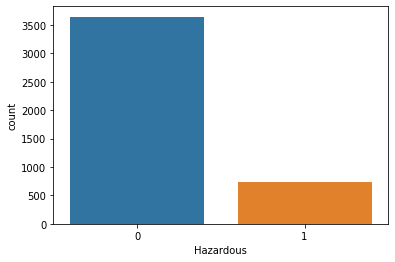

In [215]:
# Controleer of de dataset gebalanceerd is. 
sns.countplot(x="Hazardous", data=nasa)

In [216]:
nasa['Hazardous'].value_counts()


0    3645
1     732
Name: Hazardous, dtype: int64

In [217]:
nasa['Hazardous'].value_counts(normalize=True)

0    0.832762
1    0.167238
Name: Hazardous, dtype: float64

In [218]:
# Antwoord: De data is niet gebalanceerd. Er is een sterk overwicht aan de categorie '0' of te wel niet hazardous.
# Dit zal in de machine learning modellen ertoe leiden dat deze categorie overgerepresenteerd zal zijn en 

Splits eerst de features op in een training- en test set. 

Zorg ervoor dat er exact **1000 samples** in de test set steken en gebruik een **random_state = 0**.

In [219]:
# Opsplitsen in features en targets. 
y_nasa = nasa['Hazardous'].values.astype('int')
X_nasa = pd.DataFrame(nasa.drop('Hazardous', axis=1))
X_nasa.head()

,Absolute Magnitude,Est Dia in KM(min),Est Dia in KM(max),Relative Velocity km per sec,Relative Velocity km per hr,Miss Dist.(Astronomical),Miss Dist.(lunar),Miss Dist.(kilometers),Orbit Uncertainity,Minimum Orbit Intersection,Jupiter Tisserand Invariant,Epoch Osculation,Eccentricity,Semi Major Axis,Inclination,Asc Node Longitude,Orbital Period,Perihelion Distance,Perihelion Arg,Aphelion Dist,Perihelion Time,Mean Anomaly,Mean Motion,Orbit ID_1,Orbit ID_2,Orbit ID_3,Orbit ID_4,Orbit ID_5,Orbit ID_6,Orbit ID_7,Orbit ID_8,Orbit ID_9,Orbit ID_10,Orbit ID_11,Orbit ID_12,Orbit ID_13,Orbit ID_14,Orbit ID_15,Orbit ID_16,Orbit ID_17,Orbit ID_18,Orbit ID_19,Orbit ID_20,Orbit ID_21,Orbit ID_22,Orbit ID_23,Orbit ID_24,Orbit ID_25,Orbit ID_26,Orbit ID_27,Orbit ID_28,Orbit ID_29,Orbit ID_30,Orbit ID_31,Orbit ID_32,Orbit ID_33,Orbit ID_34,Orbit ID_35,Orbit ID_36,Orbit ID_37,Orbit ID_38,Orbit ID_39,Orbit ID_40,Orbit ID_41,Orbit ID_42,Orbit ID_43,Orbit ID_44,Orbit ID_45,Orbit ID_46,Orbit ID_47,Orbit ID_48,Orbit ID_49,Orbit ID_50,Orbit ID_51,Orbit ID_52,Orbit ID_53,Orbit ID_54,Orbit ID_55,Orbit ID_56,Orbit ID_57,Orbit ID_58,Orbit ID_59,Orbit ID_60,Orbit ID_61,Orbit ID_62,Orbit ID_63,Orbit ID_64,Orbit ID_65,Orbit ID_66,Orbit ID_67,Orbit ID_68,Orbit ID_69,Orbit ID_70,Orbit ID_71,Orbit ID_72,Orbit ID_73,Orbit ID_74,Orbit ID_75,Orbit ID_76,Orbit ID_77,Orbit ID_78,Orbit ID_79,Orbit ID_80,Orbit ID_81,Orbit ID_82,Orbit ID_83,Orbit ID_84,Orbit ID_85,Orbit ID_86,Orbit ID_87,Orbit ID_88,Orbit ID_89,Orbit ID_90,Orbit ID_91,Orbit ID_92,Orbit ID_93,Orbit ID_94,Orbit ID_95,Orbit ID_96,Orbit ID_97,Orbit ID_98,Orbit ID_99,Orbit ID_100,Orbit ID_101,Orbit ID_102,Orbit ID_103,Orbit ID_104,Orbit ID_105,Orbit ID_106,Orbit ID_107,Orbit ID_108,Orbit ID_109,Orbit ID_111,Orbit ID_112,Orbit ID_113,Orbit ID_114,Orbit ID_115,Orbit ID_116,Orbit ID_117,Orbit ID_119,Orbit ID_120,Orbit ID_121,Orbit ID_122,Orbit ID_123,Orbit ID_125,Orbit ID_126,Orbit ID_127,Orbit ID_128,Orbit ID_130,Orbit ID_131,Orbit ID_132,Orbit ID_133,Orbit ID_134,Orbit ID_137,Orbit ID_138,Orbit ID_140,Orbit ID_143,Orbit ID_146,Orbit ID_147,Orbit ID_148,Orbit ID_149,Orbit ID_152,Orbit ID_154,Orbit ID_156,Orbit ID_157,Orbit ID_158,Orbit ID_159,Orbit ID_163,Orbit ID_164,Orbit ID_165,Orbit ID_167,Orbit ID_170,Orbit ID_172,Orbit ID_175,Orbit ID_176,Orbit ID_182,Orbit ID_184,Orbit ID_185,Orbit ID_188,Orbit ID_190,Orbit ID_192,Orbit ID_193,Orbit ID_207,Orbit ID_211,Orbit ID_212,Orbit ID_213,Orbit ID_214,Orbit ID_229,Orbit ID_236,Orbit ID_238,Orbit ID_243,Orbit ID_253,Orbit ID_259,Orbit ID_264,Orbit ID_271,Orbit ID_278,Orbit ID_285,Orbit ID_289,Orbit ID_324,Orbit ID_328,Orbit ID_335,Orbit ID_337,Orbit ID_350,Orbit ID_358,Orbit ID_362,Orbit ID_370,Orbit ID_386,Orbit ID_412,Orbit ID_422,Orbit ID_453,Orbit ID_611
0,21.6,0.127220,0.284472,6.115834,22017.003799,0.419483,163.178711,62753692.0,5,0.025282,4634,2458000.5,0.425549,1.407011,6.025981,314.373913,609.599786,0.808259,57.257470,2.005764,2.458162e+06,264.837533,0.590551,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,21.3,0.146068,0.326618,18.113985,65210.346095,0.383014,148.992630,57298148.0,3,0.186935,5457,2458000.5,0.351674,1.107776,28.412996,136.717242,425.869294,0.718200,313.091975,1.497352,2.457795e+06,173.741112,0.845330,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,20.3,0.231502,0.517654,7.590711,27326.5601

In [220]:
# Opsplitsen in test en training_set met 1000 waarden in test set en random_state = 0. Normaliseer de features.
X_train_nasa, X_test_nasa, y_train_nasa, y_test_nasa = train_test_split(X_nasa, y_nasa, test_size=1000, random_state=0)
X_train_nasa.head()

,Absolute Magnitude,Est Dia in KM(min),Est Dia in KM(max),Relative Velocity km per sec,Relative Velocity km per hr,Miss Dist.(Astronomical),Miss Dist.(lunar),Miss Dist.(kilometers),Orbit Uncertainity,Minimum Orbit Intersection,Jupiter Tisserand Invariant,Epoch Osculation,Eccentricity,Semi Major Axis,Inclination,Asc Node Longitude,Orbital Period,Perihelion Distance,Perihelion Arg,Aphelion Dist,Perihelion Time,Mean Anomaly,Mean Motion,Orbit ID_1,Orbit ID_2,Orbit ID_3,Orbit ID_4,Orbit ID_5,Orbit ID_6,Orbit ID_7,Orbit ID_8,Orbit ID_9,Orbit ID_10,Orbit ID_11,Orbit ID_12,Orbit ID_13,Orbit ID_14,Orbit ID_15,Orbit ID_16,Orbit ID_17,Orbit ID_18,Orbit ID_19,Orbit ID_20,Orbit ID_21,Orbit ID_22,Orbit ID_23,Orbit ID_24,Orbit ID_25,Orbit ID_26,Orbit ID_27,Orbit ID_28,Orbit ID_29,Orbit ID_30,Orbit ID_31,Orbit ID_32,Orbit ID_33,Orbit ID_34,Orbit ID_35,Orbit ID_36,Orbit ID_37,Orbit ID_38,Orbit ID_39,Orbit ID_40,Orbit ID_41,Orbit ID_42,Orbit ID_43,Orbit ID_44,Orbit ID_45,Orbit ID_46,Orbit ID_47,Orbit ID_48,Orbit ID_49,Orbit ID_50,Orbit ID_51,Orbit ID_52,Orbit ID_53,Orbit ID_54,Orbit ID_55,Orbit ID_56,Orbit ID_57,Orbit ID_58,Orbit ID_59,Orbit ID_60,Orbit ID_61,Orbit ID_62,Orbit ID_63,Orbit ID_64,Orbit ID_65,Orbit ID_66,Orbit ID_67,Orbit ID_68,Orbit ID_69,Orbit ID_70,Orbit ID_71,Orbit ID_72,Orbit ID_73,Orbit ID_74,Orbit ID_75,Orbit ID_76,Orbit ID_77,Orbit ID_78,Orbit ID_79,Orbit ID_80,Orbit ID_81,Orbit ID_82,Orbit ID_83,Orbit ID_84,Orbit ID_85,Orbit ID_86,Orbit ID_87,Orbit ID_88,Orbit ID_89,Orbit ID_90,Orbit ID_91,Orbit ID_92,Orbit ID_93,Orbit ID_94,Orbit ID_95,Orbit ID_96,Orbit ID_97,Orbit ID_98,Orbit ID_99,Orbit ID_100,Orbit ID_101,Orbit ID_102,Orbit ID_103,Orbit ID_104,Orbit ID_105,Orbit ID_106,Orbit ID_107,Orbit ID_108,Orbit ID_109,Orbit ID_111,Orbit ID_112,Orbit ID_113,Orbit ID_114,Orbit ID_115,Orbit ID_116,Orbit ID_117,Orbit ID_119,Orbit ID_120,Orbit ID_121,Orbit ID_122,Orbit ID_123,Orbit ID_125,Orbit ID_126,Orbit ID_127,Orbit ID_128,Orbit ID_130,Orbit ID_131,Orbit ID_132,Orbit ID_133,Orbit ID_134,Orbit ID_137,Orbit ID_138,Orbit ID_140,Orbit ID_143,Orbit ID_146,Orbit ID_147,Orbit ID_148,Orbit ID_149,Orbit ID_152,Orbit ID_154,Orbit ID_156,Orbit ID_157,Orbit ID_158,Orbit ID_159,Orbit ID_163,Orbit ID_164,Orbit ID_165,Orbit ID_167,Orbit ID_170,Orbit ID_172,Orbit ID_175,Orbit ID_176,Orbit ID_182,Orbit ID_184,Orbit ID_185,Orbit ID_188,Orbit ID_190,Orbit ID_192,Orbit ID_193,Orbit ID_207,Orbit ID_211,Orbit ID_212,Orbit ID_213,Orbit ID_214,Orbit ID_229,Orbit ID_236,Orbit ID_238,Orbit ID_243,Orbit ID_253,Orbit ID_259,Orbit ID_264,Orbit ID_271,Orbit ID_278,Orbit ID_285,Orbit ID_289,Orbit ID_324,Orbit ID_328,Orbit ID_335,Orbit ID_337,Orbit ID_350,Orbit ID_358,Orbit ID_362,Orbit ID_370,Orbit ID_386,Orbit ID_412,Orbit ID_422,Orbit ID_453,Orbit ID_611
3074,23.6,0.050647,0.113250,10.458817,37651.739783,0.044724,17.397806,6690681.0,7,0.023309,6166,2458000.5,0.188275,0.970500,18.544141,202.525793,349.214316,0.787780,118.603277,1.153221,2.457857e+06,147.885886,1.030886,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2570,23.2,0.060891,0.136157,22.053008,79390.827266,0.492821,191.707199,73724904.0,7,0.256883,6515,2458000.5,0.423468,0.888801,28.014450,188.479702,306.058921,0.512422,2.402183,1.265180,2.457950e+06,59.956366,1.176244,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4306,22.2,0.096506,0.215794,4.774057,171

In [221]:
# Schalen van de data (alleen voor lineaire regressie)
col_to_scale = [
    'Absolute Magnitude', 'Est Dia in KM(min)', 'Est Dia in KM(max)', 'Relative Velocity km per sec', 
    'Relative Velocity km per hr', 'Miss Dist.(Astronomical)', 'Miss Dist.(lunar)', 'Miss Dist.(kilometers)', 
    'Orbit Uncertainity', 'Minimum Orbit Intersection', 'Jupiter Tisserand Invariant', 'Epoch Osculation', 
    'Eccentricity', 'Semi Major Axis', 'Inclination', 'Asc Node Longitude', 'Orbital Period', 
    'Perihelion Distance', 'Perihelion Arg', 'Aphelion Dist', 'Perihelion Time', 'Mean Anomaly', 'Mean Motion']

X_train_nasa_ss = X_train_nasa.copy()
X_test_nasa_ss = X_test_nasa.copy()

train_nasa_ss = X_train_nasa_ss[col_to_scale]
test_nasa_ss = X_test_nasa_ss[col_to_scale]

standard = StandardScaler().fit(train_nasa_ss.values)
train_nasa_ss = standard.transform(train_nasa_ss.values)
test_nasa_ss = standard.transform(test_nasa_ss.values)

X_train_nasa_ss[col_to_scale] = train_nasa_ss
X_test_nasa_ss[col_to_scale] = test_nasa_ss

X_train_nasa_ss.head()

,Absolute Magnitude,Est Dia in KM(min),Est Dia in KM(max),Relative Velocity km per sec,Relative Velocity km per hr,Miss Dist.(Astronomical),Miss Dist.(lunar),Miss Dist.(kilometers),Orbit Uncertainity,Minimum Orbit Intersection,Jupiter Tisserand Invariant,Epoch Osculation,Eccentricity,Semi Major Axis,Inclination,Asc Node Longitude,Orbital Period,Perihelion Distance,Perihelion Arg,Aphelion Dist,Perihelion Time,Mean Anomaly,Mean Motion,Orbit ID_1,Orbit ID_2,Orbit ID_3,Orbit ID_4,Orbit ID_5,Orbit ID_6,Orbit ID_7,Orbit ID_8,Orbit ID_9,Orbit ID_10,Orbit ID_11,Orbit ID_12,Orbit ID_13,Orbit ID_14,Orbit ID_15,Orbit ID_16,Orbit ID_17,Orbit ID_18,Orbit ID_19,Orbit ID_20,Orbit ID_21,Orbit ID_22,Orbit ID_23,Orbit ID_24,Orbit ID_25,Orbit ID_26,Orbit ID_27,Orbit ID_28,Orbit ID_29,Orbit ID_30,Orbit ID_31,Orbit ID_32,Orbit ID_33,Orbit ID_34,Orbit ID_35,Orbit ID_36,Orbit ID_37,Orbit ID_38,Orbit ID_39,Orbit ID_40,Orbit ID_41,Orbit ID_42,Orbit ID_43,Orbit ID_44,Orbit ID_45,Orbit ID_46,Orbit ID_47,Orbit ID_48,Orbit ID_49,Orbit ID_50,Orbit ID_51,Orbit ID_52,Orbit ID_53,Orbit ID_54,Orbit ID_55,Orbit ID_56,Orbit ID_57,Orbit ID_58,Orbit ID_59,Orbit ID_60,Orbit ID_61,Orbit ID_62,Orbit ID_63,Orbit ID_64,Orbit ID_65,Orbit ID_66,Orbit ID_67,Orbit ID_68,Orbit ID_69,Orbit ID_70,Orbit ID_71,Orbit ID_72,Orbit ID_73,Orbit ID_74,Orbit ID_75,Orbit ID_76,Orbit ID_77,Orbit ID_78,Orbit ID_79,Orbit ID_80,Orbit ID_81,Orbit ID_82,Orbit ID_83,Orbit ID_84,Orbit ID_85,Orbit ID_86,Orbit ID_87,Orbit ID_88,Orbit ID_89,Orbit ID_90,Orbit ID_91,Orbit ID_92,Orbit ID_93,Orbit ID_94,Orbit ID_95,Orbit ID_96,Orbit ID_97,Orbit ID_98,Orbit ID_99,Orbit ID_100,Orbit ID_101,Orbit ID_102,Orbit ID_103,Orbit ID_104,Orbit ID_105,Orbit ID_106,Orbit ID_107,Orbit ID_108,Orbit ID_109,Orbit ID_111,Orbit ID_112,Orbit ID_113,Orbit ID_114,Orbit ID_115,Orbit ID_116,Orbit ID_117,Orbit ID_119,Orbit ID_120,Orbit ID_121,Orbit ID_122,Orbit ID_123,Orbit ID_125,Orbit ID_126,Orbit ID_127,Orbit ID_128,Orbit ID_130,Orbit ID_131,Orbit ID_132,Orbit ID_133,Orbit ID_134,Orbit ID_137,Orbit ID_138,Orbit ID_140,Orbit ID_143,Orbit ID_146,Orbit ID_147,Orbit ID_148,Orbit ID_149,Orbit ID_152,Orbit ID_154,Orbit ID_156,Orbit ID_157,Orbit ID_158,Orbit ID_159,Orbit ID_163,Orbit ID_164,Orbit ID_165,Orbit ID_167,Orbit ID_170,Orbit ID_172,Orbit ID_175,Orbit ID_176,Orbit ID_182,Orbit ID_184,Orbit ID_185,Orbit ID_188,Orbit ID_190,Orbit ID_192,Orbit ID_193,Orbit ID_207,Orbit ID_211,Orbit ID_212,Orbit ID_213,Orbit ID_214,Orbit ID_229,Orbit ID_236,Orbit ID_238,Orbit ID_243,Orbit ID_253,Orbit ID_259,Orbit ID_264,Orbit ID_271,Orbit ID_278,Orbit ID_285,Orbit ID_289,Orbit ID_324,Orbit ID_328,Orbit ID_335,Orbit ID_337,Orbit ID_350,Orbit ID_358,Orbit ID_362,Orbit ID_370,Orbit ID_386,Orbit ID_412,Orbit ID_422,Orbit ID_453,Orbit ID_611
3074,0.455322,-0.602191,-0.602191,-0.486423,-0.486423,-1.482162,-1.482162,-1.356947,1.184863,-0.663137,0.907420,0.29169,-1.072967,-0.833432,0.500391,0.292690,-0.790158,-0.119638,-0.639364,-0.887538,0.050837,-0.319258,0.867457,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2570,0.319825,-0.557437,-0.557437,1.151568,1.151568,1.605695,1.605695,1.446751,1.184863,1.913102,1.193588,0.29169,0.250366,-0.994236,1.392605,0.156757,-0.911661,-1.271858,-1.771379,-0.766105,0.191248,-1.147738,1.297477,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4306,-0.018919,-0.401846,-0.40

Train zowel een logistic regression en SVM classifier. Je mag onmiddellijk het optimale model zoeken via cross-validation. Test deze classifiers: bepaal de accuracy, precision, recall, f1-score en ROC (waar mogelijk)

In [194]:
# Trainen en testen van een logistic regression en SVM classifier
# Initiate models
logr = linear_model.LogisticRegression(max_iter=1000)
svm = SVC(max_iter=1000)

# initiate grids
grid1 = {
    "C": np.logspace(-2,3,10),
    "class_weight": ['balanced', None, {0:1, 1:5}, {0:1, 1:10}, {0:1, 1:50}],
    "solver": ["lbfgs", "sag"]
}

grid2 = [
    {
        'kernel': ['linear'], 
        'C':np.logspace(-3,3,11), 
        'class_weight': ['balanced', None, {0:1, 1:5}, {0:1, 1:10}, {0:1, 1:50}]
        },
    {
        'kernel': ['rbf'], 
        'C': np.linspace(0.01,20,10), 
        'gamma': [0.0001, 0.001, 0.01, 0.1, 0.2], 
        'class_weight': ['balanced', None, {0:1, 1:5}, {0:1, 1:10}, {0:1, 1:50}]
        },
    {
        'kernel': ['poly'], 
        'C': np.linspace(0.01,20,10), 
        'class_weight': ['balanced', None, {0:1, 1:5}, {0:1, 1:10}, {0:1, 1:50}]
        }
]

Fitting 8 folds for each of 100 candidates, totalling 800 fits
Beste parameters:	{'C': 1.6681005372000592, 'class_weight': None, 'solver': 'sag'}
Beste score: 	0.9549896081924416


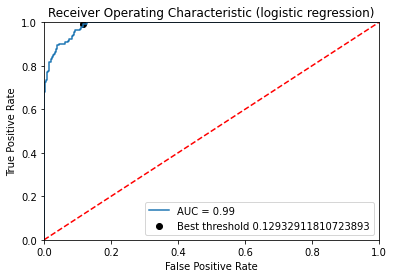

Confusion matrix


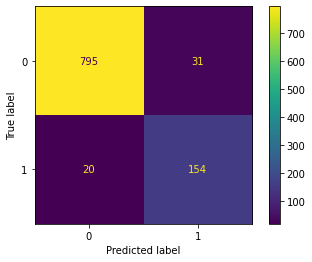

              precision    recall  f1-score   support

           0       0.98      0.96      0.97       826
           1       0.83      0.89      0.86       174

    accuracy                           0.95      1000
   macro avg       0.90      0.92      0.91      1000
weighted avg       0.95      0.95      0.95      1000



In [195]:
# Logistic regression
logr_gs = GridSearchCV(logr, grid1, cv=8, n_jobs=-1, scoring='accuracy', verbose=1)
logr_gs.fit(X_train_nasa_ss, y_train_nasa)

# Beste parameters en score
print(f"Beste parameters:\t{logr_gs.best_params_}")
print(f"Beste score: \t{logr_gs.best_score_}")

# ROC and AUC
logr_probs = logr_gs.predict_proba(X_test_nasa_ss)
logr_preds = logr_probs[:,1]
logr_fpr, logr_tpr, logr_threshold = roc_curve(y_test_nasa, logr_preds)
logr_roc_auc = auc(logr_fpr, logr_tpr)
logr_gmeans = np.sqrt(logr_tpr * (1-logr_fpr))
logr_ix = np.argmax(logr_gmeans)

plt.title(f'Receiver Operating Characteristic (logistic regression)')
plt.plot(logr_fpr, logr_tpr, label = f'AUC = {logr_roc_auc:.2f}')
plt.plot([0, 1], [0, 1],'r--')
plt.xlim([0, 1])
plt.ylim([0, 1])
plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
plt.scatter(logr_fpr[logr_ix], logr_tpr[logr_ix], marker='o', color='black', label=f'Best threshold {logr_threshold[logr_ix]}')
plt.legend(loc = 'lower right')
plt.show()

# Confusion matrix
print("Confusion matrix")
logr_pred = (logr_gs.predict(X_test_nasa_ss))
ConfusionMatrixDisplay.from_predictions(y_test_nasa, logr_pred)  
plt.show()

# Classification report
print(classification_report(y_test_nasa, logr_pred))

Fitting 8 folds for each of 355 candidates, totalling 2840 fits


C:\Users\gbroe\AppData\Roaming\Python\Python39\site-packages\sklearn\svm\_base.py:284: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(


Beste parameters:	{'C': 20.0, 'class_weight': None, 'gamma': 0.01, 'kernel': 'rbf'}
Beste score: 	0.9620965121620562


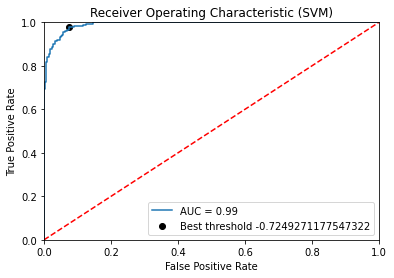

Confusion matrix


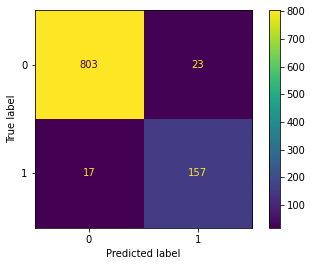

              precision    recall  f1-score   support

           0       0.98      0.97      0.98       826
           1       0.87      0.90      0.89       174

    accuracy                           0.96      1000
   macro avg       0.93      0.94      0.93      1000
weighted avg       0.96      0.96      0.96      1000



In [197]:
# Support vector machine
svm_gs = GridSearchCV(svm, grid2, cv=8, n_jobs=-1, scoring='accuracy', verbose=1)

svm_gs.fit(X_train_nasa_ss, y_train_nasa)

# Beste parameters en score
print(f"Beste parameters:\t{svm_gs.best_params_}")
print(f"Beste score: \t{svm_gs.best_score_}")

# ROC and AUC
svm_preds = svm_gs.decision_function(X_test_nasa_ss)
svm_fpr, svm_tpr, svm_threshold = roc_curve(y_test_nasa, svm_preds)
svm_roc_auc = auc(svm_fpr, svm_tpr)
svm_gmeans = np.sqrt(svm_tpr * (1-svm_fpr))
svm_ix = np.argmax(svm_gmeans)

plt.title(f'Receiver Operating Characteristic (SVM)')
plt.plot(svm_fpr, svm_tpr, label = f'AUC = {svm_roc_auc:.2f}')
plt.plot([0, 1], [0, 1],'r--')
plt.xlim([0, 1])
plt.ylim([0, 1])
plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
plt.scatter(svm_fpr[svm_ix], svm_tpr[svm_ix], marker='o', color='black', label=f'Best threshold {svm_threshold[svm_ix]}')
plt.legend(loc = 'lower right')
plt.show()

# Confusion matrix
print("Confusion matrix")
svm_pred = (svm_gs.predict(X_test_nasa_ss))
ConfusionMatrixDisplay.from_predictions(y_test_nasa, svm_pred)  
plt.show()

# Classification report
print(classification_report(y_test_nasa,svm_pred))

Train een **Random Forest Classifier**. 
- Test deze classifier op de trainingset. Wat zijn jouw bevindingen en conclusies? Vergelijk de resultaten met deze van logistic regression en SVM.

Een lijst van hyperparameters zijn te vinden via https://scikit-learn.org/stable/modules/generated/sklearn.ensemble.RandomForestClassifier.html

- Bepaal via deze random forest tree classifier de belangrijkste features. 
- Onderzoek of je via boosting (Adaboost/Gradient boosting) de accuraatheid kunt verhogen.
- Onderzoek of je via stacking tot een beter model kunt komen.
- Maak ook eens gebruik van een AutoML model TPOT (http://epistasislab.github.io/tpot/) en bespreek tot welke resultaten je daarmee komt. Vergelijk deze met de resultaten van de eigen getrainde modellen.

In [223]:
# Trainen en testen van een random forest tree classifier
rfc = RandomForestClassifier()

grid = {
    "n_estimators": range(1, 1001, 250),
    "class_weight": ['balanced', 'balanced_subsample', None, {0:1, 1:10}],
    "max_depth": [None, 5, 10, 20], 
    "min_samples_split": [2, 5, 10],
    "min_samples_leaf": [2, 5, 10],
    "max_features": ['auto', 'sqrt', 'log2']
}

rfc_gs = GridSearchCV(rfc, grid, cv=6, n_jobs=-1, scoring='accuracy', verbose=1)

rfc_gs.fit(X_train_nasa, y_train_nasa)

# Beste parameters en score
print(f"Beste parameters:\t{rfc_gs.best_params_}")
print(f"Beste score: \t{rfc_gs.best_score_}")

# ROC and AUC
rfc_disp = RocCurveDisplay.from_estimator(rfc_gs, X_test_nasa, y_test_nasa)
plt.title(f'Receiver Operating Characteristic (logistic regression)')
plt.xlim([0, 1])
plt.ylim([0, 1])
plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
plt.show()

# Confusion matrix
print("Confusion matrix")
rfc_pred = (rfc_gs.predict(X_test_nasa))
ConfusionMatrixDisplay.from_predictions(y_test_nasa, rfc_pred)  
plt.show()

# Classification report
print(classification_report(y_test_nasa,rfc_pred))

Fitting 6 folds for each of 1728 candidates, totalling 10368 fits


Bepaal uit de gertrainde Random Forest Classifier de belangrijkheid van de features (model.feature_importances_). 

Welke zijn de 10 belangrijkste features?

Train het model opnieuw met deze 10 belangrijkste features. Test het model en verklaar de resulaten.

Reduceer het aantal features nog verder en bekijk telkens de accuracy. Verklaar de resultaten.

In [12]:
# Reduceren van het aantal features en hertrainen via een random forest classifier.


Kijk of je via boosting (Adaboost/gradient boosting) de accuracy op de test set nog kunt verhogen. Het type classifier (base estimator) mag je zelf kiezen.

In [1]:
# Boosting


Train een stacking classifier. De estimators mag je zelf kiezen. Als metalearner opteer je best voor een logistic regression classifier.

In [ ]:
# Stacking


AutoML via TPOT

In [ ]:
# TPOT